**Table of contents**<a id='toc0_'></a>    
- [Cleaned Analysis of June 23rd 2023 Flight at 100 Hz](#toc1_)    
  - [Purpose:](#toc1_1_)    
  - [Methods:](#toc1_2_)    
  - [Results](#toc1_3_)    
  - [Naming and Folders](#toc1_4_)    
  - [Importing Packages and Libraries](#toc1_5_)    
  - [Importing Data](#toc1_6_)    
  - [Defining Vehicle Parameters](#toc1_7_)    
  - [Manually Selecting Masks by Plots](#toc1_8_)    
  - [Results of Manual Segmentation](#toc1_9_)    
    - [Acceleration Segments](#toc1_9_1_)    
    - [IMU Calibration Segments](#toc1_9_2_)    
  - [Checking Segments for Good Data](#toc1_10_)    
    - [Plotting Airspeeds, Altitude and Motor RPM for Checks](#toc1_10_1_)    
    - [Showing the Rotational Rate of Vehicle](#toc1_10_2_)    
    - [Checking IMU Calibration Segment](#toc1_10_3_)    
  - [Post-Flight IMU Orientation Calibration](#toc1_11_)    
    - [Calculating Body Accelerations w. Adjustment for g Magnitude](#toc1_11_1_)    
    - [Calculating Body Accelerations w, Adjustment for IMU Orientation](#toc1_11_2_)    
  - [Main Analysis for P_Req](#toc1_12_)    
    - [Power Required without IMU Orientation Adjustment](#toc1_12_1_)    
    - [Lift Measurement without IMU Orientation Adjustment](#toc1_12_2_)    
    - [Power Required With IMU Orientation Adjustment](#toc1_12_3_)    
      - [Notes for the investigation of Power Terms above](#toc1_12_3_1_)    
    - [Lift Measurement with IMU Orientation Adjustment](#toc1_12_4_)    
      - [Lift Estimate Notes](#toc1_12_4_1_)    
  - [Exporting Results](#toc1_13_)    
  - [Being More Selective About Which accelerations to use](#toc1_14_)    

<!-- vscode-jupyter-toc-config
	numbering=false
	anchor=true
	flat=false
	minLevel=1
	maxLevel=6
	/vscode-jupyter-toc-config -->
<!-- THIS CELL WILL BE REPLACED ON TOC UPDATE. DO NOT WRITE YOUR TEXT IN THIS CELL -->

# <a id='toc1_'></a>[Cleaned Analysis of June 23rd 2023 Flight at 100 Hz](#toc0_)

## <a id='toc1_1_'></a>[Purpose:](#toc0_)
* Reduce the code to just the essentials
* Comment on the results

## <a id='toc1_2_'></a>[Methods:](#toc0_)
1. Acceleration method
   1. 

## <a id='toc1_3_'></a>[Results](#toc0_)

## <a id='toc1_4_'></a>[Naming and Folders](#toc0_)

In [1]:
### Definining name of analysis ###
name = '2023-06-23_CREATeV_Acceleration_Analysis_Cleaned'
data_path = '../../data/'
data_folder = 'createv-2023-06-23'
file_name = '00000012.BIN'
datasave_path = data_path+data_folder+'/'
result_path = '../Results/'+name+'/'
figure_path = '../Figures/'+name+'/'

## <a id='toc1_5_'></a>[Importing Packages and Libraries](#toc0_)

In [2]:
# Getting packages #
from os import sys
import os
sys.path.append('../../')

%matplotlib widget

from matplotlib import pyplot as plt
import numpy as np
import pandas as pd

import plotly.express as px

import main
import propellers
import motors
from aircraft import airplane
import cl_finders

### Creating Folders for Results/Data ###
if not os.path.exists(result_path):
    os.makedirs(result_path)
if not os.path.exists(figure_path):
    os.makedirs(figure_path)
    
# Setting Plot Defaults
plt.style.use('../../basic_plotter.mplstyle')

## <a id='toc1_6_'></a>[Importing Data](#toc0_)

In [3]:
# Importing data, specifying import characteristics, backing up results
rate = "10ms"
interpolateM = "linear"
processor = "CREATeV_2023"
df = main.data_load(data_path, data_folder, file_name, rate, interpolateM, processor)

In [4]:
ct_cruise_segresult_june13 = pd.read_pickle("../Results/2022-06-15_CREATeV_Cruise_Analysis_Cleaned/ct_cruise_segresult.pkl")
build_turbulent = pd.read_pickle("../../DragBuilds/CREATeV_DragBuildTurbulent.pkl")
build_laminar = pd.read_pickle("../../DragBuilds/CREATeV_DragBuildLaminar.pkl")

## <a id='toc1_7_'></a>[Defining Vehicle Parameters](#toc0_)

In [5]:
# Vehicle parameters
prop = propellers.aeronaut20x8() # Using aeronaut 20x8 for this flight
motor = motors.U7V2_280KV()  # Using U7 V2 motor

mass = 12.502
span = 6.28
chord = 0.395
createv = airplane(mass, chord, span)

## <a id='toc1_8_'></a>[Manually Selecting Masks by Plots](#toc0_)

Using the throttle ramp beginning and end, while looking for when the advance ratio of the propeller is suitable for no singularities.  

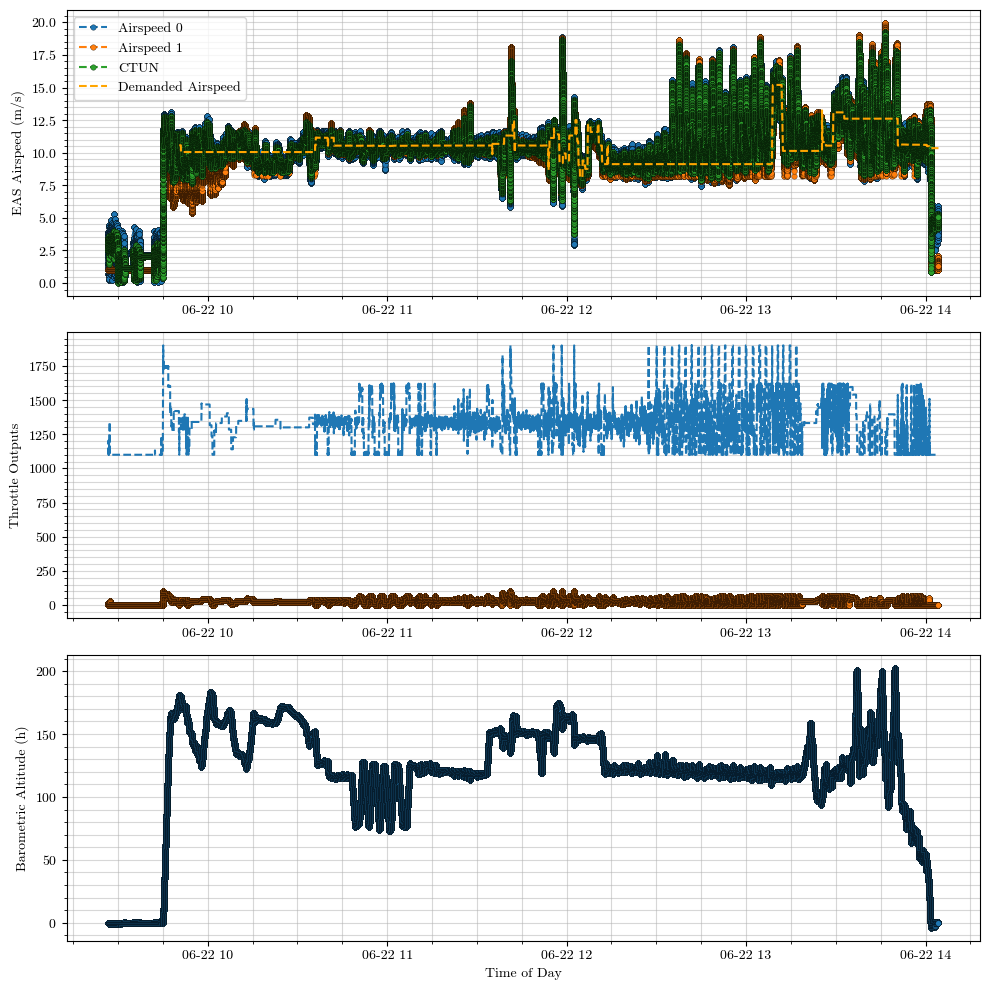

Plot already exists


In [6]:
# Generating Plots for Mask Selection

timeindex_v_thr_h = plt.figure(figsize=(10,10), dpi=100)

df.Airspeed_Sensor1 = np.where(df.Airspeed_Sensor1 < 8.2, df.Airspeed_Sensor1 + 0.976, df.Airspeed_Sensor1)
#df.loc[df.Airspeed_Sensor0 < 8.2, 'Airspeed_Sensor0'] += (9.087 - 8.111)
ax0 = plt.subplot(3,1,1)
plt.grid("On")
plt.plot(df.index, df.Airspeed_Sensor0, linestyle='--', marker='o', markersize=4, markeredgecolor=[0,0,0], label='Airspeed 0')
plt.plot(df.index, df.Airspeed_Sensor1, linestyle='--', marker='o', markersize=4, markeredgecolor=[0,0,0], label='Airspeed 1')
plt.plot(df.index, df.Airspeed_CTUN, linestyle='--', marker='o', markersize=4, markeredgecolor=[0,0,0], label='CTUN')
plt.plot(df.index, df.Airspeed_Demanded, color='orange', linestyle='--', marker='', label="Demanded Airspeed")
plt.legend(loc='upper left')
plt.ylabel("EAS Airspeed (m/s)")
ax1 = plt.subplot(3,1,2, sharex=ax0)
plt.grid("On")
plt.plot(df.index, df.ThrottleOut, linestyle='--', marker='', markersize=4, markeredgecolor=[0,0,0])
plt.plot(df.index, df.Throttle, linestyle='--', marker='o', markersize=4, markeredgecolor=[0,0,0])
plt.ylabel("Throttle Outputs")
ax2 = plt.subplot(3,1,3, sharex=ax0)
plt.grid("On")
plt.plot(df.index, df.Altitude_BARO_0, linestyle='--', marker='o', markersize=4, markeredgecolor=[0,0,0])
plt.ylabel("Barometric Altitude (h)")
plt.xlabel("Time of Day")
plt.grid("On")
plt.show()
main.save_figure(timeindex_v_thr_h, f'{timeindex_v_thr_h=}'.split('=')[0], figure_path)

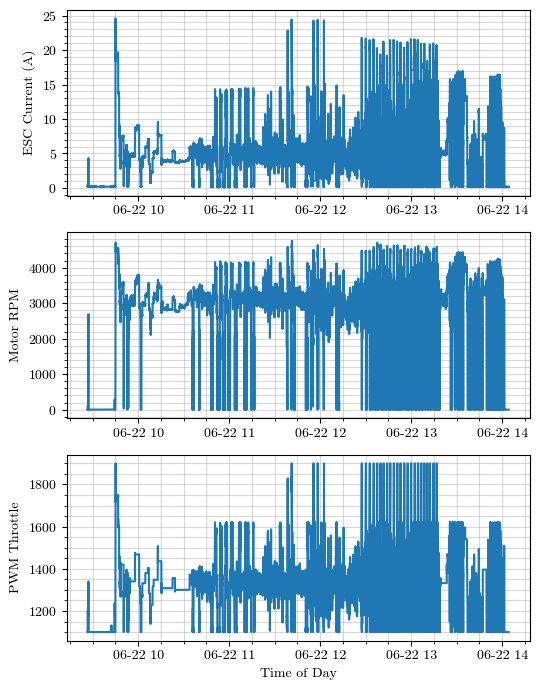

Plot already exists


In [7]:
# Plotting Propulsion Information for Mask Selection
timeindex_I_RPM_thr = plt.figure(figsize=(5.5,7), dpi=100)

ax0 = plt.subplot(3,1,1)
ax0.plot(df.index, df.MainBatteryCurrent, linestyle='-', marker='', markersize=4, markeredgecolor=[0,0,0])
ax0.set_ylabel("ESC Current (A)")
ax1 = plt.subplot(3,1,2, sharex=ax0)
ax1.plot(df.index, df.MotorRPM, linestyle='-', marker='', markersize=4, markeredgecolor=[0,0,0])
ax1.set_ylabel("Motor RPM")
ax2 = plt.subplot(3,1,3, sharex=ax0)
ax2.plot(df.index, df.ThrottleOut, linestyle='-', marker='', markersize=4, markeredgecolor=[0,0,0])
ax2.set_ylabel("PWM Throttle")
ax2.set_xlabel("Time of Day")
plt.show()
main.save_figure(timeindex_I_RPM_thr, f'{timeindex_I_RPM_thr=}'.split('=')[0], figure_path)

## <a id='toc1_9_'></a>[Results of Manual Segmentation](#toc0_)

### <a id='toc1_9_1_'></a>[Acceleration Segments](#toc0_)

In [8]:
year = 2023
month = 6
day = 22

# Acceleration Masking from the above figures
seg_times = np.array([['12:27:16','12:27:26'],
                      ['12:29:50','12:30:10'],
                      ['12:32:24','12:32:44'],
                      ['12:34:54','12:35:20'],
                      ['12:37:15','12:37:40'],
                      ['12:39:26','12:39:51'],
                      ['12:41:29','12:41:54'],
                      ['12:43:45','12:44:10'],
                      ['12:45:52','12:46:16'],
                      ['12:48:20','12:48:40'],
                      ['12:50:36','12:50:59'],
                      ['12:52:46','12:53:05'],
                      ['12:55:10','12:55:34'],
                      ['12:57:20','12:57:49'],
                      ['12:59:44','13:00:06'],
                      ['13:02:05','13:02:30'],
                      ['13:04:17','13:04:42'],
                      ['13:06:25','13:06:47'],
                      ['13:08:39','13:08:42'],
                      ['13:10:29','13:10:42'],
                      ['13:12:13','13:12:28'],
                      ['13:14:29','13:14:47'],
                      ['13:16:36','13:16:55']])

masks = cl_finders.get_maskarray(df, seg_times, year, month, day)

### <a id='toc1_9_2_'></a>[IMU Calibration Segments](#toc0_)

In [9]:
seg_zeroing = np.array([['9:42:00','9:44:00']])
acc_masks = cl_finders.get_maskarray(df, seg_zeroing, year, month, day)

## <a id='toc1_10_'></a>[Checking Segments for Good Data](#toc0_)

Calculating intermediate variables for display

In [10]:
# Calculation of Intermediate Variables

# Gravity
g = 9.807

# Attitude 
phi = np.deg2rad(df["RollAngle"].to_numpy())            # Bank angle in radians
theta = np.deg2rad(df["PitchAngle"].to_numpy())         # Pitch angle in radians

# Atmospheric adjustments:
rho = df["Pressure_BARO0"].to_numpy() * (287 * (df["Temperature_ARSP"].to_numpy()+273.15))**-1             # Density found from barometer pressure & airspeed sensor temperatures
v_eas = df["Airspeed_Sensor1"].to_numpy()                               # Equivalent SSL airspeed (m/s)
v_tas = v_eas * np.sqrt(1.225) * np.sqrt(rho)**-1   # the true airspeed
q = 0.5 * rho * v_tas**2                            # Dynamic pressure 

# For Descent method
h = df["Altitude_POS"].to_numpy()                      # Altitude
Vd_eas = df["DescentRate"].to_numpy()                  # Descent Rate from EKF (is it true or EAS at SSL?)
Vd_tas = Vd_eas * np.sqrt(1.225) * np.sqrt(rho)**-1    # the true airspeed
gamma = np.arcsin(-Vd_tas/v_tas) ####Should this be negative or positive
alpha = gamma + theta

# Propulsion characterization
n = df["MotorRPM"].to_numpy() / 60                      # Revolutions per second
i_esc = df["MainBatteryCurrent"].to_numpy()             # Really the ESC voltage and current here
v_esc = df["MainBatteryVoltage"].to_numpy()
J = v_tas / (n * prop.diameter)
eff = prop.efficiency(J) * motor.efficiency(n, i_esc)

# Inertial Measurement Unit
xp_acc = df.XAcc_IMU0.to_numpy()                       # Acceleration in X direction of the IMU
yp_acc = df.YAcc_IMU0.to_numpy()                       # Acceleration in Y direction of the IMU
zp_acc = df.ZAcc_IMU0.to_numpy()                       # Acceleration in Z direction of the IMU

# Original Rotations
U_dot = xp_acc - g * np.sin(theta)#- g * np.sin(theta)
V_dot = yp_acc + (g * np.cos(theta) * np.sin(phi))
W_dot = zp_acc + (g * np.cos(theta) * np.cos(phi))

gamma = np.arcsin(-Vd_tas/v_tas)
alpha = theta - gamma # gamma + theta

U = v_tas * np.cos(alpha)
V = 0
W = v_tas * np.sin(alpha)

P = df.GyroX_IMU0 
Q = df.GyroY_IMU0
R = df.GyroZ_IMU0

/var/folders/x_/hvhbycx15x31bybxtb1h9ktc0000gn/T/ipykernel_47785/1481300275.py:11: RuntimeWarning: invalid value encountered in reciprocal
  rho = df["Pressure_BARO0"].to_numpy() * (287 * (df["Temperature_ARSP"].to_numpy()+273.15))**-1             # Density found from barometer pressure & airspeed sensor temperatures
/var/folders/x_/hvhbycx15x31bybxtb1h9ktc0000gn/T/ipykernel_47785/1481300275.py:13: RuntimeWarning: invalid value encountered in reciprocal
  v_tas = v_eas * np.sqrt(1.225) * np.sqrt(rho)**-1   # the true airspeed
/var/folders/x_/hvhbycx15x31bybxtb1h9ktc0000gn/T/ipykernel_47785/1481300275.py:19: RuntimeWarning: invalid value encountered in reciprocal
  Vd_tas = Vd_eas * np.sqrt(1.225) * np.sqrt(rho)**-1    # the true airspeed
/var/folders/x_/hvhbycx15x31bybxtb1h9ktc0000gn/T/ipykernel_47785/1481300275.py:27: RuntimeWarning: divide by zero encountered in true_divide
  J = v_tas / (n * prop.diameter)
/Users/williamkemp/Records/Repositories/CREATeV_AnalysisSuite/Investigations/

### <a id='toc1_10_1_'></a>[Plotting Airspeeds, Altitude and Motor RPM for Checks](#toc0_)

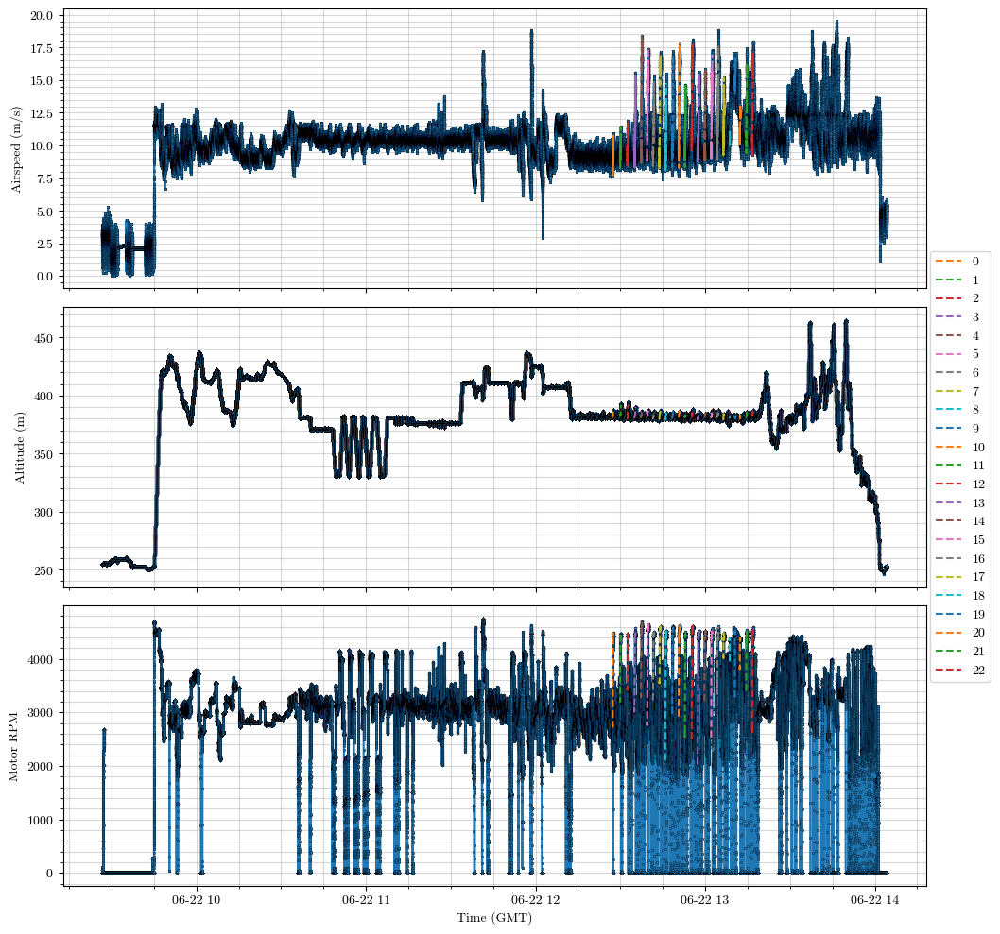

Plot already exists


In [11]:
# Airspeed for Segments
[timeindex_v_h_RPM_fullsegmented, axs] = plt.subplots(3,1, sharex=True, figsize=(10,10), dpi=100)
# timeindex_v_h_RPM_segmented.subplots_adjust(right=0.2, left=0.1)

axs[0].plot(df.index, df.Airspeed_Sensor0)
for i in np.arange(len(masks)):
    axs[0].plot(df.Airspeed_Sensor0[masks[i]], marker='', linestyle='--', label=str(i) + "")
axs[0].set_ylabel("Airspeed (m/s)")

# Altitude for Segments
axs[1].plot(df.index, df.Altitude_POS)
for i in np.arange(len(masks)):
    axs[1].plot(df.Altitude_POS[masks[i]], marker='', linestyle='--')#, label=str(i) + "")
axs[1].set_ylabel("Altitude (m)")
# axs[1].legend(loc='center left',
#           ncol=2, fancybox=True, bbox_to_anchor=(1.04, 0.5))

# RPM for Segments
axs[2].plot(df.index, df.MotorRPM)
for i in np.arange(len(masks)):
    axs[2].plot(df.MotorRPM[masks[i]], marker='', linestyle='--')#, label=str(i) + "")
axs[2].set_ylabel("Motor RPM")
axs[2].set_xlabel("Time (GMT)")

timeindex_v_h_RPM_fullsegmented.legend(loc=7, bbox_to_anchor=(1.06, 0.5))
#timeindex_v_segmented.tight_layout(rect=[0, 0, 1.2, 1.2])
plt.show()
main.save_figure(timeindex_v_h_RPM_fullsegmented, f'{timeindex_v_h_RPM_fullsegmented=}'.split('=')[0], figure_path)

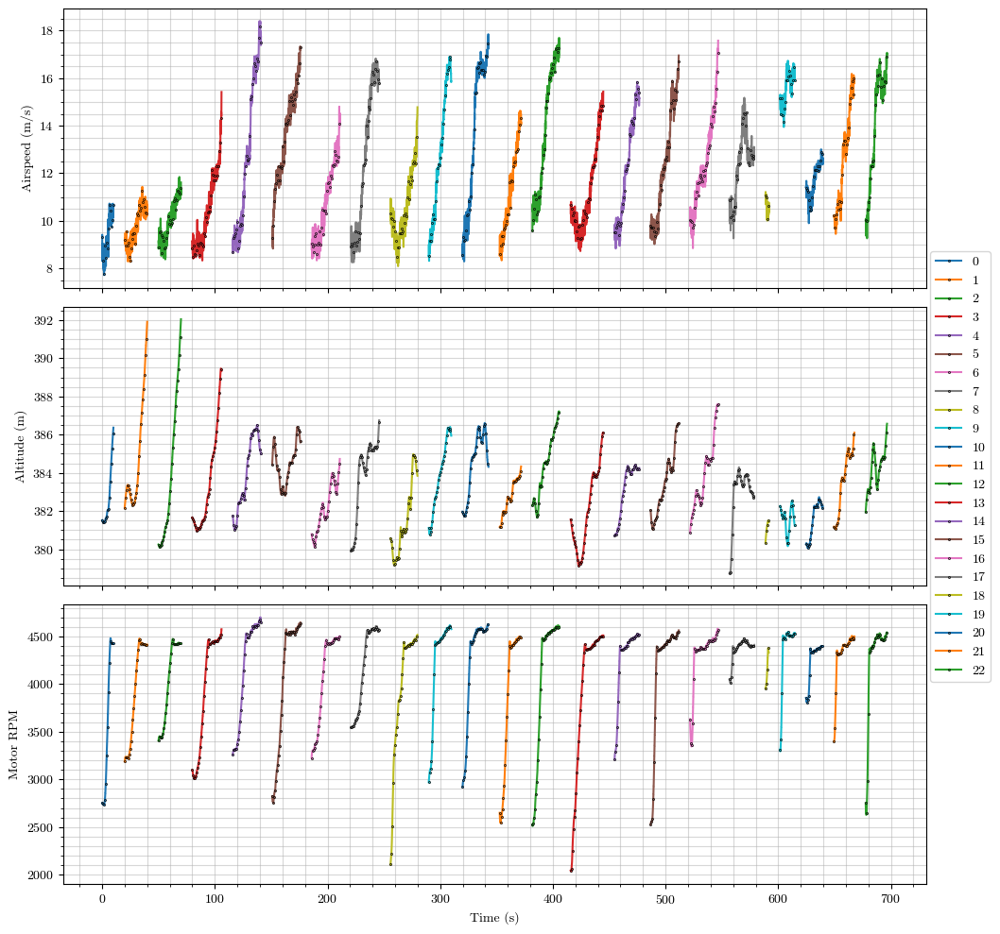

Plot already exists


In [12]:
# Airspeed for Segments
[timeindex_v_h_RPM_segmented, axs] = plt.subplots(3,1, sharex=True, figsize=(10,10), dpi=100)
# timeindex_v_h_RPM_segmented.subplots_adjust(right=0.2, left=0.1)

markerevery=80
markedgew=0.5
t_init = 0
dT = 0.01
for i in range(len(masks)):
    segment_length = len(v_tas[masks[i]])            # Integer segment length
    time_s = np.linspace(t_init, (segment_length-1)*dT + t_init, segment_length)
    # Airspeed for Segments
    axs[0].plot(time_s, df.Airspeed_Sensor0[masks[i]], linestyle='-', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew,label=str(i) + "")
    # Altitude for Segments
    axs[1].plot(time_s, df.Altitude_POS[masks[i]], linestyle='-' , markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew)#, label=str(i) + "")
    # RPM for Segments
    axs[2].plot(time_s, df.MotorRPM[masks[i]], linestyle='-', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew)#, label=str(i) + "")
    t_init = time_s[-1]+10
axs[0].set_ylabel("Airspeed (m/s)")
axs[1].set_ylabel("Altitude (m)")
axs[2].set_ylabel("Motor RPM")
axs[2].set_xlabel("Time (s)")

timeindex_v_h_RPM_segmented.legend(loc=7, bbox_to_anchor=(1.06, 0.5))
#timeindex_v_segmented.tight_layout(rect=[0, 0, 1.2, 1.2])
plt.show()
main.save_figure(timeindex_v_h_RPM_segmented, f'{timeindex_v_h_RPM_segmented=}'.split('=')[0], figure_path)

### <a id='toc1_10_2_'></a>[Showing the Rotational Rate of Vehicle](#toc0_)

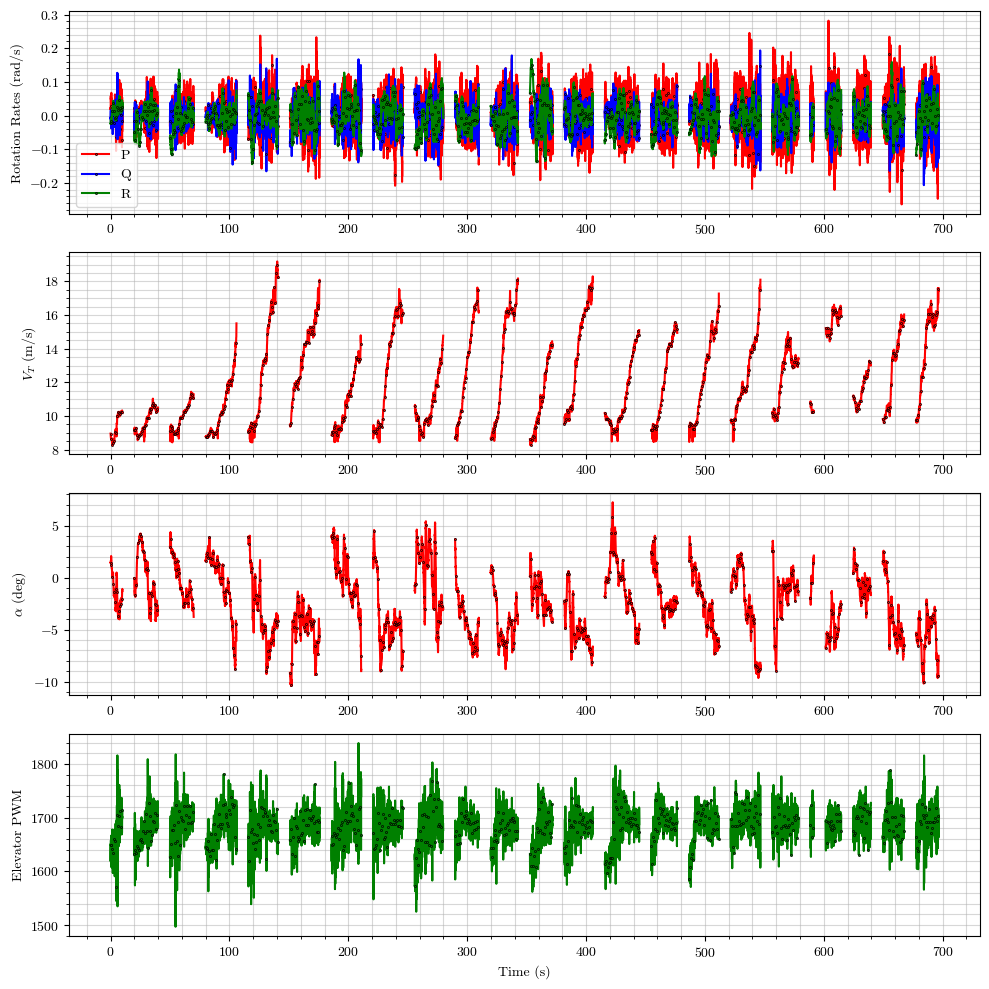

In [13]:
plt.figure(figsize=(10,10))
plt.tight_layout()
t_init = 0
markerevery=80
markedgew=0.5

ax1 = plt.subplot(4,1,1)
ax2 = plt.subplot(4,1,2, sharex=ax1)
ax3 = plt.subplot(4,1,3, sharex=ax1)
ax4 = plt.subplot(4,1,4, sharex=ax1)
for i in range(len(masks)):
    dT = 0.01
    segment_length = len(v_tas[masks[i]])            # Integer segment length
    time_s = np.linspace(t_init, (segment_length-1)*dT + t_init, segment_length)
    ax1.plot(time_s, P[masks[i]], color='r', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew, label='P')
    ax1.plot(time_s, Q[masks[i]], color='b', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew, label='Q')
    ax1.plot(time_s, R[masks[i]], color='g', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew, label='R')
    if i == 0:
        ax1.legend()
    ax1.set_ylabel("Rotation Rates (rad/s)")
    ax2.plot(time_s, v_tas[masks[i]], color='r', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew)
    ax2.set_ylabel("$V_T$ (m/s)")
    ax3.plot(time_s, np.rad2deg(alpha[masks[i]]), color='r', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew)
    ax3.set_ylabel("$\\alpha$ (deg)")
    ax4.plot(time_s, df.ElevatorOut[masks[i]], color='g', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew)
    ax4.set_ylabel("Elevator PWM")
    ax4.set_xlabel("Time (s)")
    t_init = time_s[-1]+10
plt.show()

### <a id='toc1_10_3_'></a>[Checking IMU Calibration Segment](#toc0_)

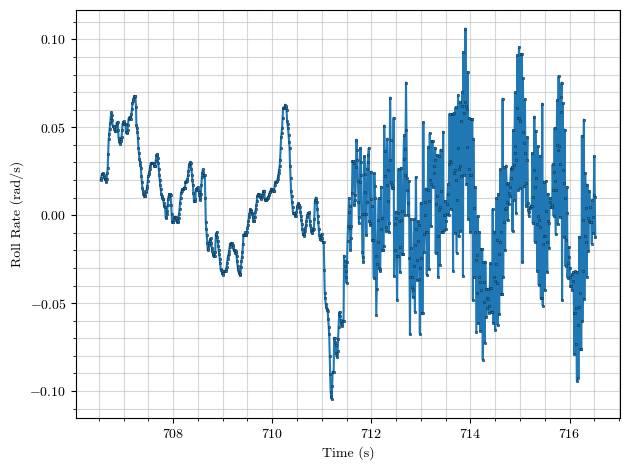

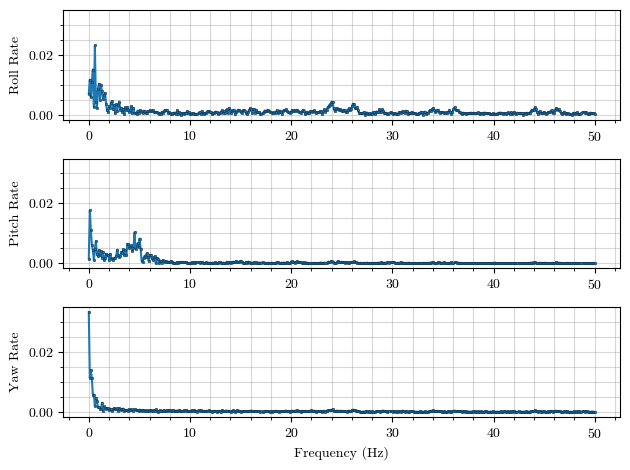

In [14]:
# Generating FFT of rotation rates

i = 0

segment_length = len(v_tas[masks[i]])            # Integer segment length
time_s = np.linspace(t_init, (segment_length-1)*dT + t_init, segment_length)

plt.figure()
plt.plot(time_s, P[masks[i]])
plt.xlabel("Time (s)")
plt.ylabel("Roll Rate (rad/s)")
plt.show()

# Getting Rates for Single Acceleration
p_fft = np.fft.fft(P[masks[i]])
q_fft = np.fft.fft(Q[masks[i]])
r_fft = np.fft.fft(R[masks[i]])

xf = np.linspace(0.0, 1.0/(2.0*dT), segment_length//2)

plt.figure()

ax0 = plt.subplot(3,1,1)
ax1 = plt.subplot(3,1,2, sharey=ax0)
ax2 = plt.subplot(3,1,3, sharey=ax0)
ax0.plot(xf, 2.0/segment_length * np.abs(p_fft[:segment_length//2]))
ax1.plot(xf, 2.0/segment_length * np.abs(q_fft[:segment_length//2]))
ax2.plot(xf, 2.0/segment_length * np.abs(r_fft[:segment_length//2]))
ax0.set_ylabel("Roll Rate")
ax1.set_ylabel("Pitch Rate")
ax2.set_ylabel("Yaw Rate")
ax2.set_xlabel("Frequency (Hz)")
plt.show()

# plt.figure()
# plt.ylabel("Reconstructed Roll Rates")
# plt.xlabel("Time (s)")
# plt.plot(time_s, np.fft.ifft(p_fft))
# plt.show()

## <a id='toc1_11_'></a>[Post-Flight IMU Orientation Calibration](#toc0_)

Intended to fix any issues with the IMU being oriented differently from the aircrafts body frame axes.  The concept is to use a segment of data where the vehicle is stationary, and use that to confirm that the Euler Angles can be used to remove the effects of gravity from the IMU body acceleration measurements.  In addition, the magnitude of gravitational acceleration can be found from the stationary segment and used to remove gravitational acceleration as closely as possible.  

Items to be adjusted:
1. $\theta$ angle perturbed to make $\dot{U}$, $\dot{W}$ mean zero
2. $\phi$ angle perturbed to make $\dot{V}$ mean zero
3. $g$ taken as total sum of all raw IMU accelerations
4. Angle of attack, calculated using the adjusted pitch angle 

### <a id='toc1_11_1_'></a>[Calculating Body Accelerations w. Adjustment for g Magnitude](#toc0_)

In [15]:
thetap = 1.15 * (np.pi/180)  # Pitch perturbation from IMU orientation (Degrees)
phip = -1.3 * (np.pi/180)  # Roll perturbation from IMU orientation (Degrees)

IMUtotal = (np.sqrt(xp_acc**2 + yp_acc**2 + zp_acc**2))
g_IMU = np.mean(IMUtotal[acc_masks[0]])

U_dot = xp_acc - g_IMU * np.sin(theta)
V_dot = yp_acc + g_IMU * np.cos(theta) * np.sin(phi)
W_dot = zp_acc + g_IMU * np.cos(theta) * np.cos(phi)

### <a id='toc1_11_2_'></a>[Calculating Body Accelerations w, Adjustment for IMU Orientation](#toc0_)

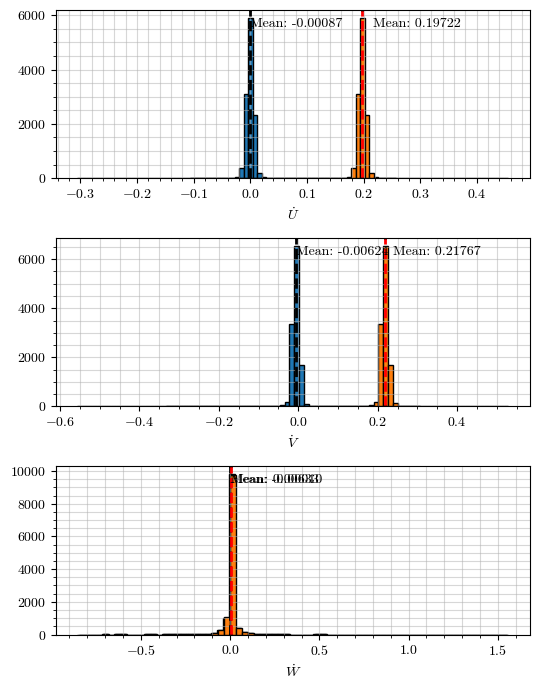

In [16]:
U_dotp = xp_acc - (g_IMU * np.sin(theta+thetap))
V_dotp = yp_acc + (g_IMU * np.cos(theta+thetap) * np.sin(phi+phip))
W_dotp = zp_acc + (g_IMU * np.cos(theta+thetap) * np.cos(phi+phip))

alpha_adjusted = (theta+thetap) - gamma

def plot_hist(masks):

    plt.figure(figsize=(5.5, 7))
    plt.title("Body Accelerations in X Direction")
    i = 0
    ax0 = plt.subplot(3,1,1)
    ax0.hist(U_dotp[masks[i]], bins=71, edgecolor='k', label='Adjusted')
    ax0.hist(U_dot[masks[i]], bins=71, edgecolor='k', label='Original')
    ax0.axvline(np.mean(U_dotp[masks[i]]), color='k', linestyle='dashed', linewidth=2)
    ax0.axvline(np.mean(U_dot[masks[i]]), color='r', linestyle='dashed', linewidth=2)
    ax0.set_xlabel("$\dot{U}$")
    min_ylim, max_ylim = ax0.set_ylim()
    ax0.text(U_dotp[masks[i]].mean()*1.1, max_ylim*0.9, 'Mean: {:.5f}'.format(U_dotp[masks[i]].mean()))
    ax0.text(U_dot[masks[i]].mean()*1.1, max_ylim*0.9, 'Mean: {:.5f}'.format(U_dot[masks[i]].mean()))

    ax1 = plt.subplot(3,1,2)
    ax1.hist(V_dotp[masks[i]], bins=71, edgecolor='k', label='Adjusted')
    ax1.hist(V_dot[masks[i]], bins=71, edgecolor='k', label='Original')
    ax1.axvline(np.mean(V_dotp[masks[i]]), color='k', linestyle='dashed', linewidth=2)
    ax1.axvline(np.mean(V_dot[masks[i]]), color='r', linestyle='dashed', linewidth=2)
    ax1.set_xlabel("$\dot{V}$")
    min_ylim, max_ylim = ax1.set_ylim()
    ax1.text(V_dotp[masks[i]].mean()*1.1, max_ylim*0.9, 'Mean: {:.5f}'.format(V_dotp[masks[i]].mean()))
    ax1.text(V_dot[masks[i]].mean()*1.1, max_ylim*0.9, 'Mean: {:.5f}'.format(V_dot[masks[i]].mean()))

    ax2 = plt.subplot(3,1,3)
    ax2.hist(W_dotp[masks[i]], bins=71, edgecolor='k', label='Adjusted')
    ax2.hist(W_dot[masks[i]], bins=71, edgecolor='k', label='Original')
    ax2.axvline(np.mean(W_dotp[masks[i]]), color='k', linestyle='dashed', linewidth=2)
    ax2.axvline(np.mean(W_dot[masks[i]]), color='r', linestyle='dashed', linewidth=2)
    ax2.set_xlabel("$\dot{W}$")
    min_ylim, max_ylim = ax2.set_ylim()
    ax2.text(W_dotp[masks[i]].mean()*1.1, max_ylim*0.9, 'Mean: {:.5f}'.format(W_dotp[masks[i]].mean()))
    ax2.text(W_dot[masks[i]].mean()*1.1, max_ylim*0.9, 'Mean: {:.5f}'.format(W_dot[masks[i]].mean()))

    plt.show()

plot_hist(acc_masks)

## <a id='toc1_12_'></a>[Main Analysis for P_Req](#toc0_)

### <a id='toc1_12_1_'></a>[Power Required without IMU Orientation Adjustment](#toc0_)

In [17]:
CT = prop.thrust_coeff(J)
T = CT * rho * n**2 * prop.diameter**4


# Power Required Individual Terms
P_req_t1 = (T * v_tas)
P_req_t2 = (mass * g * Vd_tas)
P_req_t3 = -(mass * U_dot * v_tas)
P_req_t4 = -(mass * W_dot * v_tas * alpha)
P_req_t5 = mass * v_tas * (Q*U*alpha - Q*W)
P_req_t6 = mass * v_tas * (R*V - P*V)

P_req_simple = P_req_t1 + P_req_t2 + P_req_t3
P_req_wdot = P_req_t1 + P_req_t2 + P_req_t3 + P_req_t4
P_req_rates = P_req_t1 + P_req_t2 + P_req_t3 + P_req_t4 + P_req_t5 + P_req_t6

D_simple = P_req_simple / v_tas
D_wdot = P_req_wdot / v_tas
D_rates = P_req_rates / v_tas

CD_simple = D_simple / (0.5 * rho * v_tas**2 * createv.area)
CD_wdot = D_wdot / (0.5 * rho * v_tas**2 * createv.area)
CD_rates = D_rates / (0.5 * rho * v_tas**2 * createv.area)

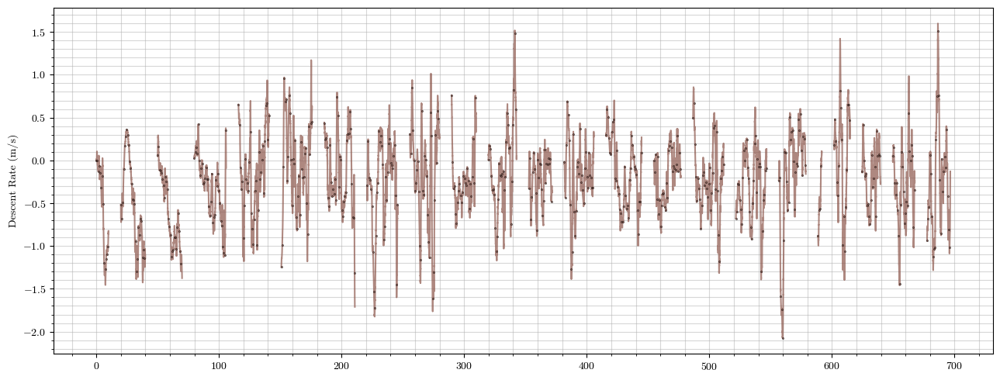

In [18]:
# Airspeed for Segments
[fig, axs] = plt.subplots(1,1, sharex=True, figsize=(13,5), dpi=100)
# timeindex_v_h_RPM_segmented.subplots_adjust(right=0.2, left=0.1)

markerevery=80
markedgew=0.5
t_init = 0
dT = 0.01
for i in range(len(masks)):
    segment_length = len(v_tas[masks[i]])            # Integer segment length
    time_s = np.linspace(t_init, (segment_length-1)*dT + t_init, segment_length)
    # Airspeed for Segments
    axs.plot(time_s, Vd_tas[masks[i]], linestyle='-', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew, color='#8c564b', alpha=0.7)
    t_init = time_s[-1]+10
axs.set_ylabel("Descent Rate (m/s)")

plt.show()
# main.save_figure(timeindex_v_h_RPM_segmented, f'{timeindex_v_h_RPM_segmented=}'.split('=')[0], figure_path)

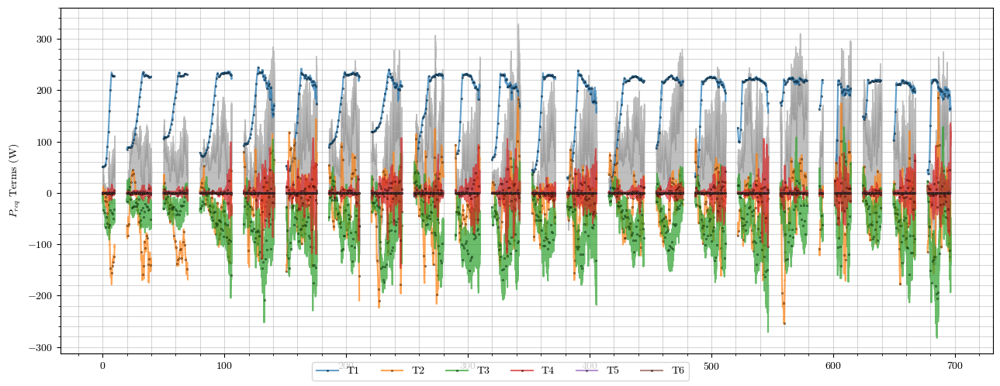

In [19]:
# Power Required Terms Comparison
[fig, axs] = plt.subplots(1,1, sharex=True, figsize=(13,5), dpi=100)
# timeindex_v_h_RPM_segmented.subplots_adjust(right=0.2, left=0.1)

markerevery=80
markedgew=0.5
t_init = 0
dT = 0.01
for i in range(len(masks)):
    segment_length = len(v_tas[masks[i]])            # Integer segment length
    time_s = np.linspace(t_init, (segment_length-1)*dT + t_init, segment_length)
    # Airspeed for Segments
    axs.plot(time_s, P_req_t1[masks[i]], linestyle='-', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew, color='#1f77b4', alpha=0.7)
    axs.plot(time_s, P_req_t2[masks[i]], linestyle='-', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew, color='#ff7f0e', alpha=0.7)
    axs.plot(time_s, P_req_t3[masks[i]], linestyle='-', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew, color='#2ca02c', alpha=0.7)
    axs.plot(time_s, P_req_t4[masks[i]], linestyle='-', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew, color='#d62728', alpha=0.7)
    axs.plot(time_s, P_req_t5[masks[i]], linestyle='-', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew, color='#9467bd', alpha=0.7)
    axs.plot(time_s, P_req_t6[masks[i]], linestyle='-', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew, color='#8c564b', alpha=0.7)
    axs.fill_between(time_s, np.zeros(np.shape(P_req_wdot[masks[i]])), P_req_wdot[masks[i]], color='grey', alpha=0.5)
    t_init = time_s[-1]+10

fig.legend(["T1", "T2", "T3", "T4", "T5", "T6"], loc='lower center', ncol=6)
axs.set_ylabel("$P_{req}$ Terms (W)")

plt.show()
# main.save_figure(timeindex_v_h_RPM_segmented, f'{timeindex_v_h_RPM_segmented=}'.split('=')[0], figure_path)

### <a id='toc1_12_2_'></a>[Lift Measurement without IMU Orientation Adjustment](#toc0_)

In [20]:
L_t1 = createv.weight * np.ones(np.shape(W_dot))
L_t2 = -1*(createv.mass * W_dot)
L_t3 = -1*(alpha*T)
L_t4 = alpha*createv.mass*U_dot

L_simple = L_t1 + L_t2
L_full = L_t1 + L_t2 + L_t3 + L_t4

CL_simple = L_simple / (0.5 * rho * v_tas**2 * createv.area)
CL_full = L_full / (0.5 * rho * v_tas**2 * createv.area)
# CL = cl_finders.cl_usbanked(createv, q, phi, W_dot)

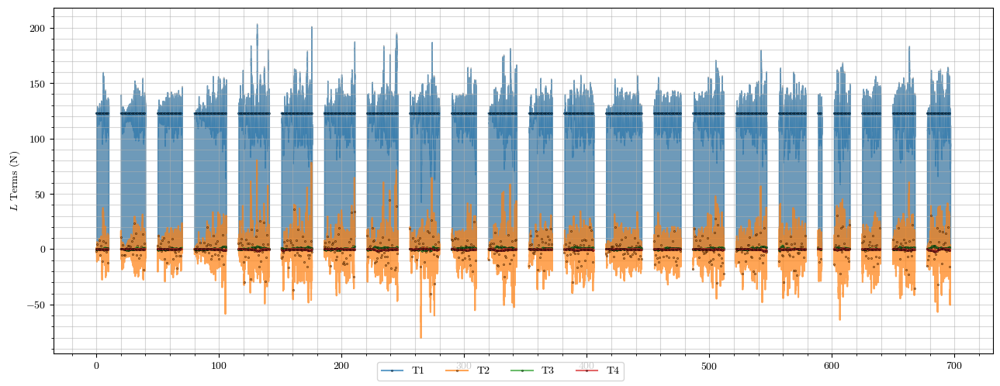

In [21]:
# Lift Term Comparison
[fig, axs] = plt.subplots(1,1, sharex=True, figsize=(13,5), dpi=100)
# timeindex_v_h_RPM_segmented.subplots_adjust(right=0.2, left=0.1)

markerevery=80
markedgew=0.5
t_init = 0
dT = 0.01
for i in range(len(masks)):
    segment_length = len(v_tas[masks[i]])            # Integer segment length
    time_s = np.linspace(t_init, (segment_length-1)*dT + t_init, segment_length)
    # Airspeed for Segments
    axs.plot(time_s, L_t1[masks[i]], linestyle='-', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew, color='#1f77b4', alpha=0.7)
    axs.plot(time_s, L_t2[masks[i]], linestyle='-', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew, color='#ff7f0e', alpha=0.7)
    axs.plot(time_s, L_t3[masks[i]], linestyle='-', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew, color='#2ca02c', alpha=0.7)
    axs.plot(time_s, L_t4[masks[i]], linestyle='-', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew, color='#d62728', alpha=0.7)
    axs.fill_between(time_s, np.zeros(np.shape(L_full[masks[i]])), L_full[masks[i]], color='grey', alpha=0.5)
    axs.fill_between(time_s, np.zeros(np.shape(L_simple[masks[i]])), L_simple[masks[i]], color='#1f77b4', alpha=0.5)
    t_init = time_s[-1]+10

fig.legend(["T1", "T2", "T3", "T4"], loc='lower center', ncol=6)
axs.set_ylabel("$L$ Terms (N)")

plt.show()
# main.save_figure(timeindex_v_h_RPM_segmented, f'{timeindex_v_h_RPM_segmented=}'.split('=')[0], figure_path)

### <a id='toc1_12_3_'></a>[Power Required With IMU Orientation Adjustment](#toc0_)

In [22]:
# Beginning Power Required Calculation without IMU Orientation Adjustment

P_req_t1 = (T * v_tas)
P_req_t2 = (mass * g * Vd_tas)
P_req_t3 = -(mass * U_dotp * v_tas)
P_req_t4 = -(mass * W_dotp * v_tas * alpha)
P_req_t5 = mass * v_tas * (Q*U*alpha_adjusted - Q*W)
P_req_t6 = mass * v_tas * (R*V - P*V)

P_req_simple = P_req_t1 + P_req_t2 + P_req_t3
P_req_wdot = P_req_t1 + P_req_t2 + P_req_t3 + P_req_t4
P_req_rates = P_req_t1 + P_req_t2 + P_req_t3 + P_req_t4 + P_req_t5 + P_req_t6

D_simple = P_req_simple / v_tas
D_wdot = P_req_wdot / v_tas
D_rates = P_req_rates / v_tas

CD_simple_comp = D_simple / (0.5 * rho * v_tas**2 * createv.area) # still need to estimate the wing area of createv
CD_wdot_comp = D_wdot / (0.5 * rho * v_tas**2 * createv.area) # still need to estimate the wing area of createv
CD_rates_comp = D_rates / (0.5 * rho * v_tas**2 * createv.area) # still need to estimate the wing area of createv

In [23]:
from scipy.signal import butter, lfilter, freqz

def butter_lowpass(cutoff, fs, order=5):
    return butter(order, cutoff, fs=fs, btype='low', analog=False)

def butter_lowpass_filter(data, cutoff, fs, order=5):
    b, a = butter_lowpass(cutoff, fs, order=order)
    y = lfilter(b, a, data)
    return y

# Filter requirements.
order = 6
fs = 100.0       # sample rate, Hz
cutoff = 1  # desired cutoff frequency of the filter, Hz
v_tas[0]=v_tas[1]
v_tasfiltered = butter_lowpass_filter(v_tas, cutoff, fs, order)

dv_tasfiltered = np.diff(v_tasfiltered)/(1/100.0)
dv_tasfiltered = np.append(dv_tasfiltered, 0)

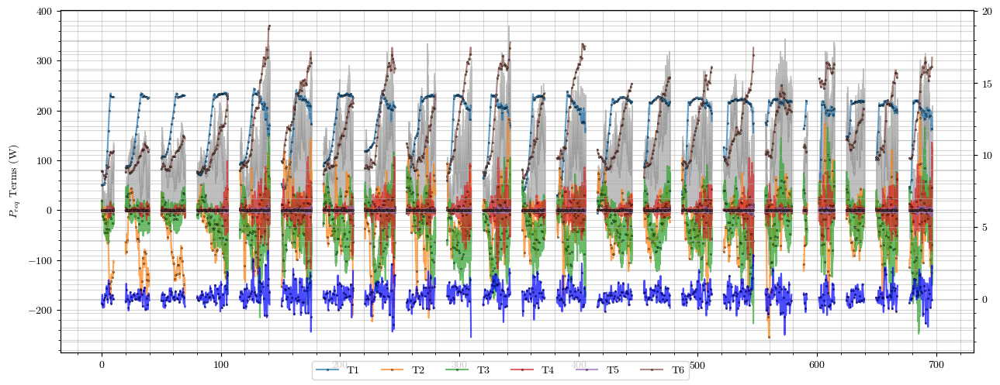

In [24]:
# Power required Terms Comparison w. Adjustment
[fig, axs] = plt.subplots(1,1, sharex=True, figsize=(13,5), dpi=100)
# timeindex_v_h_RPM_segmented.subplots_adjust(right=0.2, left=0.1)

markerevery=80
markedgew=0.5
t_init = 0
dT = 0.01
axs2 = axs.twinx()
for i in range(len(masks)):
    segment_length = len(v_tas[masks[i]])            # Integer segment length
    time_s = np.linspace(t_init, (segment_length-1)*dT + t_init, segment_length)
    # Airspeed for Segments
    axs.plot(time_s, P_req_t1[masks[i]], linestyle='-', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew, color='#1f77b4', alpha=0.7)
    axs.plot(time_s, P_req_t2[masks[i]], linestyle='-', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew, color='#ff7f0e', alpha=0.7)
    axs.plot(time_s, P_req_t3[masks[i]], linestyle='-', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew, color='#2ca02c', alpha=0.7)
    axs.plot(time_s, P_req_t4[masks[i]], linestyle='-', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew, color='#d62728', alpha=0.7)
    axs.plot(time_s, P_req_t5[masks[i]], linestyle='-', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew, color='#9467bd', alpha=0.7)
    axs.plot(time_s, P_req_t6[masks[i]], linestyle='-', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew, color='#8c564b', alpha=0.7)
    axs2.plot(time_s, v_tasfiltered[masks[i]], linestyle='-', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew, color='#8c564b', alpha=0.7)
    axs2.plot(time_s, dv_tasfiltered[masks[i]], linestyle='-', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew, color='blue', alpha=0.7)
    axs.fill_between(time_s, np.zeros(np.shape(P_req_wdot[masks[i]])), P_req_wdot[masks[i]], color='grey', alpha=0.5)
    t_init = time_s[-1]+10
fig.legend(["T1", "T2", "T3", "T4", "T5", "T6"], loc='lower center', ncol=6)
axs.set_ylabel("$P_{req}$ Terms (W)")

plt.show()
# main.save_figure(timeindex_v_h_RPM_segmented, f'{timeindex_v_h_RPM_segmented=}'.split('=')[0], figure_path)

#### <a id='toc1_12_3_1_'></a>[Notes for the investigation of Power Terms above](#toc0_)

By comparing the power required terms for those with IMU re-orientation, its clear that the IMU orientation has a tremendous effect on the U dot power term.  By doing the rotation, the overall acceleration in X is offset since it contains a component of gravitational acceleration.  

One way to verify that the acceleration in X is roughly correct would be to take the time derivative of airspeed, however airspeed is incredibly noisy.  Therefore, airspeed was low pass filtered to make the time derivative less noisy.  The end result was that the U dot couldn't be verified by the airspeed time derivative, since airspeed is so shaky.  This is precisely because of the small mass of the vehicle, and the airspeed data being so aweful.  

### <a id='toc1_12_4_'></a>[Lift Measurement with IMU Orientation Adjustment](#toc0_)

#### <a id='toc1_12_4_1_'></a>[Lift Estimate Notes](#toc0_)

The IMU orientation doesn't affect the calculation of the lift coefficient substantially!
We can ignore these effects, and focus only on the gravity component and the W dot component to the lift.  

## Collecting Total Results for Polar

### No IMU Adjustment Results

In [26]:
# Collecting Total CL, CD's
cl_total = cl_finders.total_segments_boolean(CL_simple, masks)
cd_wdot_total = cl_finders.total_segments_boolean(CD_wdot, masks)


[cl_bin_means, cl_bin_stds, cl_bin_ci95s, cd_bin_means, cd_bin_stds, cd_bin_ci95s] = cl_finders.collect_bins(np.linspace(0.2, 1.4, 50), cl_total, cd_wdot_total)

/var/folders/x_/hvhbycx15x31bybxtb1h9ktc0000gn/T/ipykernel_37552/1581149388.py:15: RuntimeWarning: Mean of empty slice.
  cl_means = [cl_total[digitized == i].mean() for i in range(1, len(bins))]
/Users/williamkemp/opt/anaconda3/envs/superwake-records/lib/python3.10/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/var/folders/x_/hvhbycx15x31bybxtb1h9ktc0000gn/T/ipykernel_37552/1581149388.py:16: RuntimeWarning: Mean of empty slice.
  cd_means = [cdaoa_total[digitized == i].mean() for i in range(1, len(bins))]
/var/folders/x_/hvhbycx15x31bybxtb1h9ktc0000gn/T/ipykernel_37552/1581149388.py:26: RuntimeWarning: Mean of empty slice.
  cl_means_1 = [cl_total_1[digitized == i].mean() for i in range(1, len(bins))]
/var/folders/x_/hvhbycx15x31bybxtb1h9ktc0000gn/T/ipykernel_37552/1581149388.py:27: RuntimeWarning: Mean of empty slice.
  cd_means_1 = [cd_total_1[digitized == i].mean() for i in range(1, len(bin

[0.02070024 1.83105421 0.        ]
[0.01995193 1.69982548]


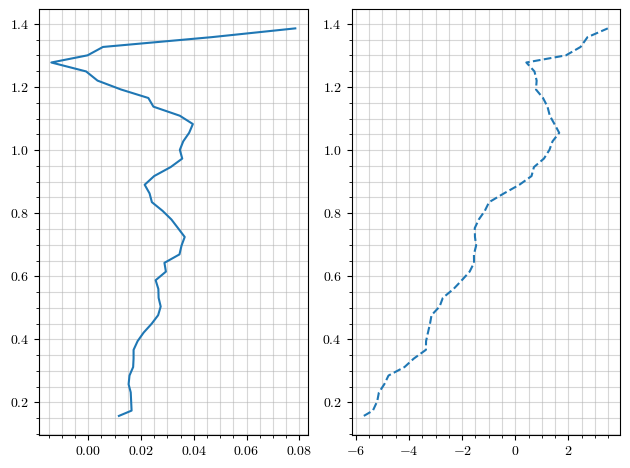

/var/folders/x_/hvhbycx15x31bybxtb1h9ktc0000gn/T/ipykernel_37552/1581149388.py:87: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  plt.colorbar(label='Angle of Attack $\\alpha$')


Plot already exists


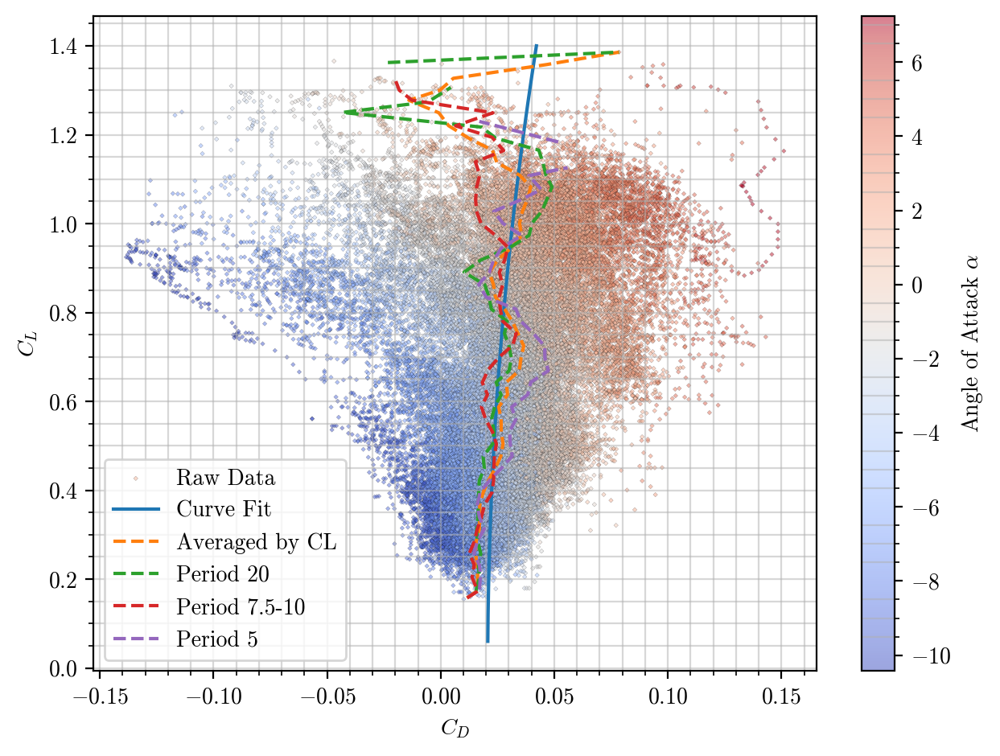

/var/folders/x_/hvhbycx15x31bybxtb1h9ktc0000gn/T/ipykernel_37552/1581149388.py:101: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  plt.colorbar(label='Angle of Attack $\\alpha$')


Plot already exists


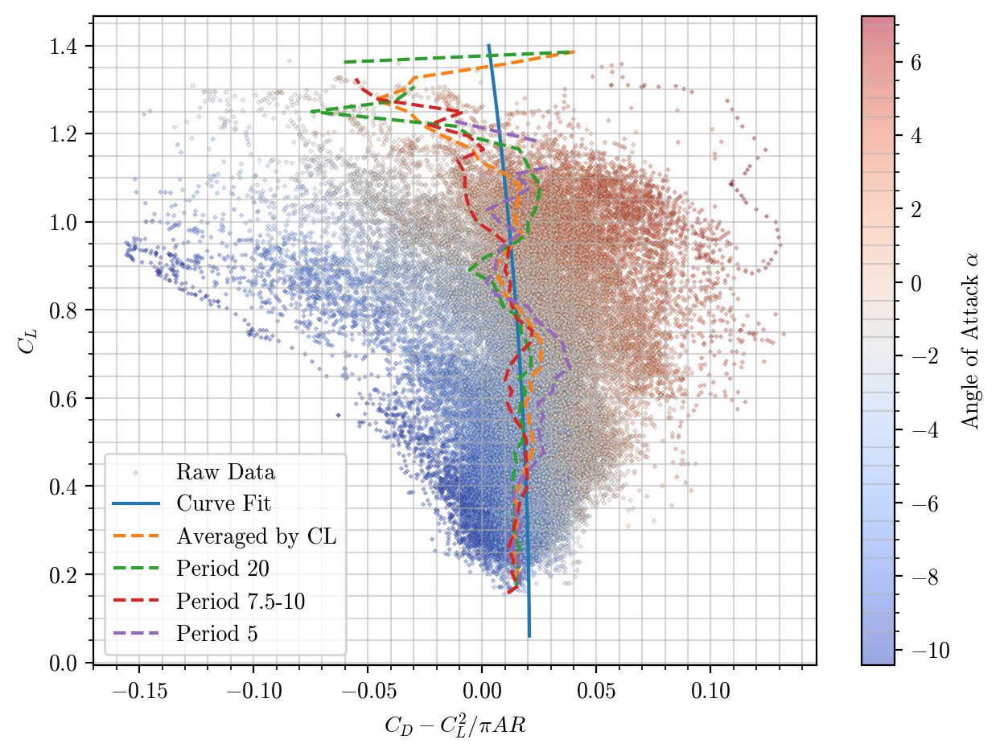

/var/folders/x_/hvhbycx15x31bybxtb1h9ktc0000gn/T/ipykernel_37552/1581149388.py:125: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  plt.colorbar(label='Angle of Attack $\\alpha$')


Plot already exists


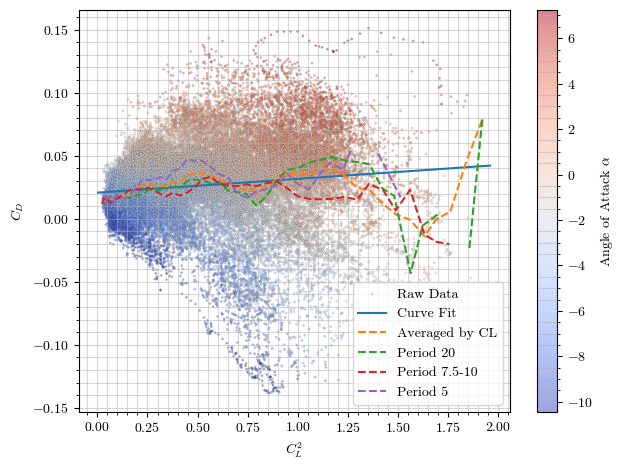

In [ ]:
# Getting Drag and Lift Coefficients for the correct moments in the flight

bins = np.linspace(0.05, 1.4, 50)

cl_total = np.array([])
cd_total = np.array([])
cdaoa_total = np.array([])
aoa_total = np.array([])
for i in range(len(masks)):
    cl_total = np.append(cl_total, CL[masks[i]])
    cd_total = np.append(cd_total, CD[masks[i]])
    cdaoa_total = np.append(cdaoa_total, CD_r2[masks[i]])
    aoa_total = np.append(aoa_total, alpha[masks[i]])
digitized = np.digitize(cl_total, bins)
cl_means = [cl_total[digitized == i].mean() for i in range(1, len(bins))]
cd_means = [cdaoa_total[digitized == i].mean() for i in range(1, len(bins))]

# Period 20
cl_total_1 = np.array([])
cd_total_1 = np.array([])
selection = np.arange(1, 8, 1)
for i in selection:
    cl_total_1 = np.append(cl_total_1, CL[masks[i]])
    cd_total_1 = np.append(cd_total_1, CD_r2[masks[i]])
digitized = np.digitize(cl_total_1, bins)
cl_means_1 = [cl_total_1[digitized == i].mean() for i in range(1, len(bins))]
cd_means_1 = [cd_total_1[digitized == i].mean() for i in range(1, len(bins))]

# Period 7.5 to 10
cl_total_2 = np.array([])
cd_total_2 = np.array([])
selection = [8, 9, 10, 11, 12, 14]
for i in selection:
    cl_total_2 = np.append(cl_total_2, CL[masks[i]])
    cd_total_2 = np.append(cd_total_2, CD_r2[masks[i]])
digitized = np.digitize(cl_total_2, bins)
cl_means_2 = [cl_total_2[digitized == i].mean() for i in range(1, len(bins))]
cd_means_2 = [cd_total_2[digitized == i].mean() for i in range(1, len(bins))]

# Period 5
cl_total_3 = np.array([])
cd_total_3 = np.array([])
selection = np.arange(15, 23, 1)
for i in selection:
    cl_total_3 = np.append(cl_total_3, CL[masks[i]])
    cd_total_3 = np.append(cd_total_3, CD_r2[masks[i]])
digitized = np.digitize(cl_total_3, bins)
cl_means_3 = [cl_total_3[digitized == i].mean() for i in range(1, len(bins))]
cd_means_3 = [cd_total_3[digitized == i].mean() for i in range(1, len(bins))]

# savemat('../Results/cl_total.mat', {'cl_total': cl_total})
# savemat('../Results/cd_total.mat', {'cd_total': cd_total})
polar_acceleration = cl_finders.cd2polar(createv, cdaoa_total, cl_total, highorder=True)
polar_acceleration_lo = cl_finders.cd2polar(createv, cd_total, cl_total, highorder=False)

polar_2021 = pd.read_pickle('../Results/2022-06-15_ct.pkl')
polar_2022_ct = np.array([polar_2021.Polar[0], polar_2021.Polar[1], polar_2021.Polar[2]])

# #polar_acceleration[1] = 0.9
print(polar_acceleration)
print(polar_acceleration_lo)

CL_fitted, CD_fitted = cl_finders.plotfittedpolar(createv, polar_acceleration, np.array([0.06, 1.4]))
CL_2022, CD_2022 = cl_finders.plotfittedpolar(createv, polar_2022_ct, np.array([0.06, 1.4]))
# plt.figure()
# plt.plot(cd_total_1, cl_total_1, marker='d', markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew, linestyle='')
# plt.plot(cdgood_means, clgood_means, marker='s', markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew, linestyle='')
# plt.show()


fig_dragpolar = plt.figure(dpi=200)
plt.scatter(cdaoa_total, cl_total, c=np.rad2deg(aoa_total), cmap='coolwarm', marker='D', alpha=0.5, edgecolors=[0,0,0], s=2, linewidths=0.1, label='Raw Data')
plt.plot(CD_fitted, CL_fitted, marker='', markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew, linestyle='-', label='Curve Fit')
plt.plot(cd_means, np.array(cl_means), marker='', markeredgecolor=[0,0,0], markersize=5, markeredgewidth=markedgew, linestyle='--', label='Averaged by CL')
plt.plot(cd_means_1, np.array(cl_means_1), marker='', markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew, linestyle='--', label='Period 20')
plt.plot(cd_means_2, np.array(cl_means_2), marker='', markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew, linestyle='--', label='Period 7.5-10')
plt.plot(cd_means_3, np.array(cl_means_3), marker='', markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew, linestyle='--', label='Period 5')

plt.legend()
plt.colorbar(label='Angle of Attack $\\alpha$')
plt.xlabel("$C_D$")
plt.ylabel("$C_L$")
main.save_figure(fig_dragpolar, f'{fig_dragpolar=}'.split('=')[0], figure_path)
plt.show()

fig_dragpolarnell = plt.figure(dpi=200)
plt.scatter(cl_finders.rem_ellipticalperf(cl_total, cdaoa_total, createv), cl_total, c=np.rad2deg(aoa_total), cmap='coolwarm', marker='D', alpha=0.5, edgecolors=[0,0,0], s=2, linewidths=0.1, label='Raw Data')
plt.plot(cl_finders.rem_ellipticalperf(CL_fitted, CD_fitted, createv), CL_fitted, marker='', markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew, linestyle='-', label='Curve Fit')
plt.plot(cl_finders.rem_ellipticalperf(np.array(cl_means), cd_means, createv), np.array(cl_means), marker='', markeredgecolor=[0,0,0], markersize=5, markeredgewidth=markedgew, linestyle='--', label='Averaged by CL')
plt.plot(cl_finders.rem_ellipticalperf(np.array(cl_means_1), cd_means_1, createv), np.array(cl_means_1), marker='', markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew, linestyle='--', label='Period 20')
plt.plot(cl_finders.rem_ellipticalperf(np.array(cl_means_2), cd_means_2, createv), np.array(cl_means_2), marker='', markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew, linestyle='--', label='Period 7.5-10')
plt.plot(cl_finders.rem_ellipticalperf(np.array(cl_means_3), cd_means_3, createv), np.array(cl_means_3), marker='', markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew, linestyle='--', label='Period 5')
plt.legend()
plt.colorbar(label='Angle of Attack $\\alpha$')
plt.xlabel("$C_D - C_L^2 / \pi AR$")
plt.ylabel("$C_L$")
main.save_figure(fig_dragpolarnell, f'{fig_dragpolarnell=}'.split('=')[0], figure_path)
plt.show()

# plt.figure()
# plt.plot(cd_total, cl_total, marker=markerstyle, alpha=0.5, markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew, linestyle='')
# plt.plot(cdaoa_total, cl_total, marker='D', alpha=0.5, markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew, linestyle='')
# plt.plot(CD_fitted, CL_fitted, marker=markerstyle, markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew, linestyle='-')
# plt.plot(cd_means, cl_means, marker=markerstyle, markeredgecolor=[0,0,0], markersize=5, markeredgewidth=markedgew, linestyle='')
# #plt.plot(cdgood_means, clgood_means, marker='s', markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew, linestyle='')
# plt.plot(CD_2021, CL_2021, marker=markerstyle, markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew, linestyle='-')
# plt.show()
# P_acc, EAS = cl_finders.polar2preqew(createv, polar_acceleration, (9,28), createvstandardweight=False)

fig_linearpolar = plt.figure()
plt.scatter(cl_total**2,cdaoa_total, c=np.rad2deg(aoa_total), cmap='coolwarm', marker='D', alpha=0.5, edgecolors=[0,0,0], s=2, linewidths=0.1, label='Raw Data')
plt.plot(CL_fitted**2, CD_fitted, marker='', markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew, linestyle='-', label='Curve Fit')
plt.plot(np.array(cl_means)**2, cd_means, marker='', markeredgecolor=[0,0,0], markersize=5, markeredgewidth=markedgew, linestyle='--', label='Averaged by CL')
plt.plot(np.array(cl_means_1)**2, cd_means_1, marker='', markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew, linestyle='--', label='Period 20')
plt.plot(np.array(cl_means_2)**2, cd_means_2, marker='', markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew, linestyle='--', label='Period 7.5-10')
plt.plot(np.array(cl_means_3)**2, cd_means_3, marker='', markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew, linestyle='--', label='Period 5')
plt.legend()
plt.colorbar(label='Angle of Attack $\\alpha$')
plt.ylabel("$C_D$")
plt.xlabel("$C_L ^2$")
main.save_figure(fig_linearpolar, f'{fig_linearpolar=}'.split('=')[0], figure_path)
plt.show()

Plotting averages of each run, seeing if there are large differences between them.  If there are, trying to hypothesize about solutions for excluding certain data.  

/Users/williamkemp/Records/Repositories/CREATeV_AnalysisSuite/Investigations/21_Cleaned_Performance_Analysis/../../cl_finders.py:401: RuntimeWarning: Mean of empty slice.
  cl_means = [total_lift_coeffs[digitized == i].mean() for i in range(1, len(bins))]
/Users/williamkemp/opt/anaconda3/envs/superwake-records/lib/python3.10/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/williamkemp/opt/anaconda3/envs/superwake-records/lib/python3.10/site-packages/numpy/core/_methods.py:262: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/williamkemp/opt/anaconda3/envs/superwake-records/lib/python3.10/site-packages/numpy/core/_methods.py:222: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
/Users/williamkemp/opt/anaconda3/envs/superwake-records/lib/python3.1

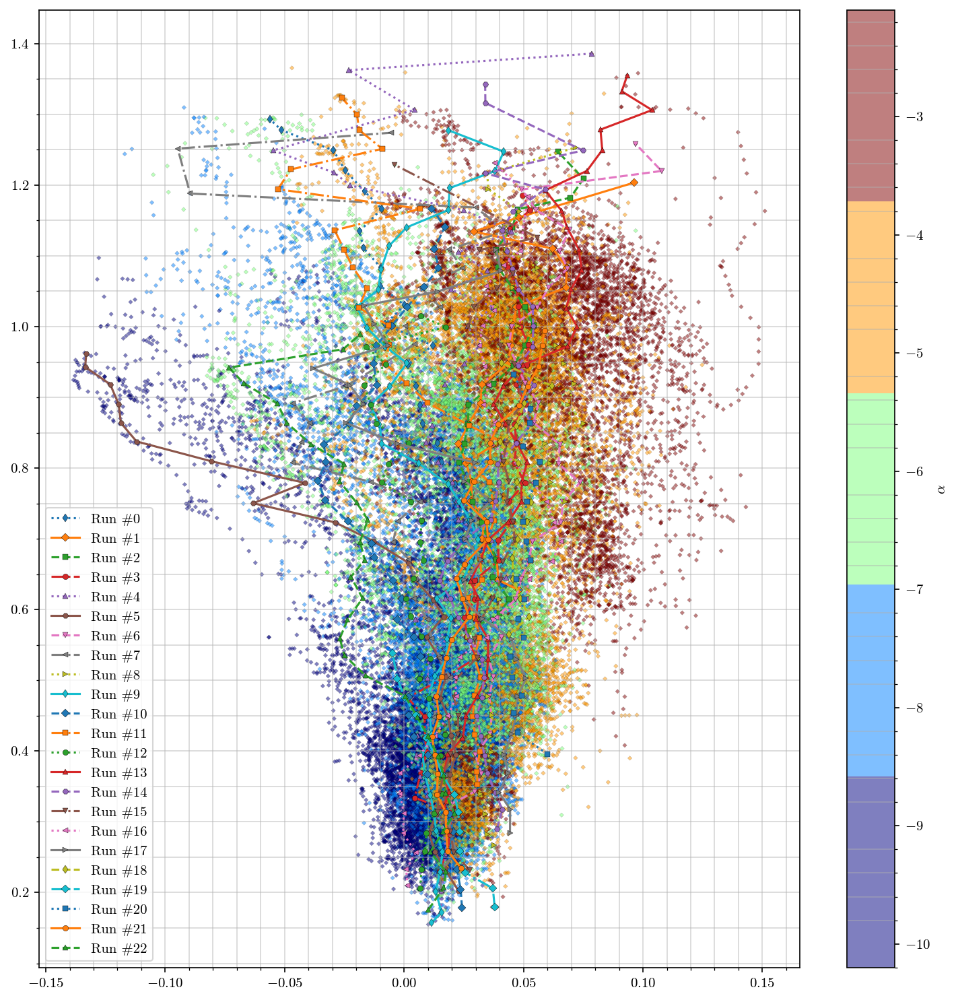

In [ ]:
import itertools

marker = itertools.cycle(('d', 'D', 's', 'o', '^', 'H', 'v', '<', '>'))
linestyles = itertools.cycle(('dotted', 'solid', 'dashed', 'dashdot'))

# Plotting AOA values
plt.figure(figsize=(10,10), dpi=150)
cmap = plt.get_cmap('jet', 5)
for i in range(len(masks)):
    cl_total_run = cl_finders.total_segments_boolean(CL, masks, np.array([i]))
    cd_total_run = cl_finders.total_segments_boolean(CD_r2, masks, [i])

    aoa_total_run = cl_finders.total_segments_boolean(alpha, masks, [i])
    P_total_run = cl_finders.total_segments_boolean(P, masks, [i])
    Q_total_run = cl_finders.total_segments_boolean(Q, masks, [i])
    theta_total_run = cl_finders.total_segments_boolean(theta, masks, [i])
    gamma_total_run = cl_finders.total_segments_boolean(gamma, masks, [i])
    h_dot_total_run = cl_finders.total_segments_boolean(Vd_tas, masks, [i])

    [cl_means_run, NaN, NaN, cd_means_run, NaN, NaN] = cl_finders.collect_bins(bins, cl_total_run, cd_total_run)
    plt.plot(cd_means_run, cl_means_run, linestyle=next(linestyles), marker=next(marker), label="Run #"+str(i))
    plt.scatter(cd_total_run, cl_total_run, c=np.rad2deg(aoa_total_run), cmap=cmap, marker='D', alpha=0.5, edgecolors=[0,0,0], s=5, linewidths=0.1)

plt.colorbar(label='$\\alpha$')
plt.legend()
plt.show()

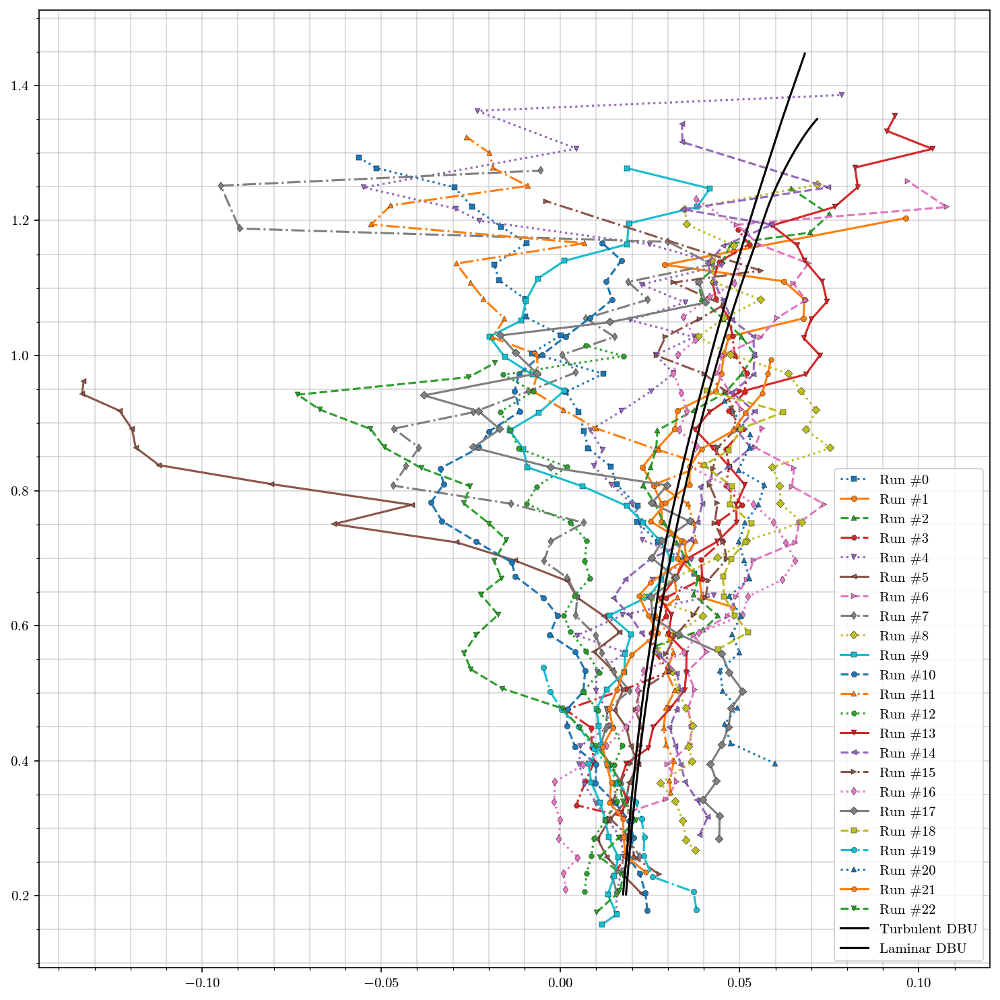

In [ ]:

# Plotting gamma values
plt.figure(figsize=(10,10), dpi=150)
cmap = plt.get_cmap('PuOr', 5)

for i in range(len(masks)):
    cl_total_run = cl_finders.total_segments_boolean(CL, masks, np.array([i]))
    cd_total_run = cl_finders.total_segments_boolean(CD_r2, masks, [i])

    aoa_total_run = cl_finders.total_segments_boolean(alpha, masks, [i])
    P_total_run = cl_finders.total_segments_boolean(P, masks, [i])
    Q_total_run = cl_finders.total_segments_boolean(Q, masks, [i])
    theta_total_run = cl_finders.total_segments_boolean(theta, masks, [i])
    gamma_total_run = cl_finders.total_segments_boolean(gamma, masks, [i])
    h_dot_total_run = cl_finders.total_segments_boolean(Vd_tas, masks, [i])

    [cl_means_run, NaN, NaN, cd_means_run, NaN, NaN] = cl_finders.collect_bins(bins, cl_total_run, cd_total_run)
    plt.plot(cd_means_run, cl_means_run, linestyle=next(linestyles), marker=next(marker), label="Run #"+str(i))
    # plt.scatter(cd_total_run, cl_total_run, c=np.rad2deg(gamma_total_run), cmap=cmap, marker='o', alpha=1, edgecolors=[0,0,0], s=7, linewidths=0.1)
plt.plot(build_turbulent.CD, build_turbulent.CL, marker='', color='black', linestyle='solid', label="Turbulent DBU")
plt.plot(build_laminar.CD, build_laminar.CL, marker='', color='black', linestyle='solid', label="Laminar DBU")
# plt.colorbar(label='$\gamma$')
plt.legend()
plt.show()

/var/folders/x_/hvhbycx15x31bybxtb1h9ktc0000gn/T/ipykernel_37552/2312798291.py:19: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  plt.colorbar(label='Angle of Attack $\\alpha$')


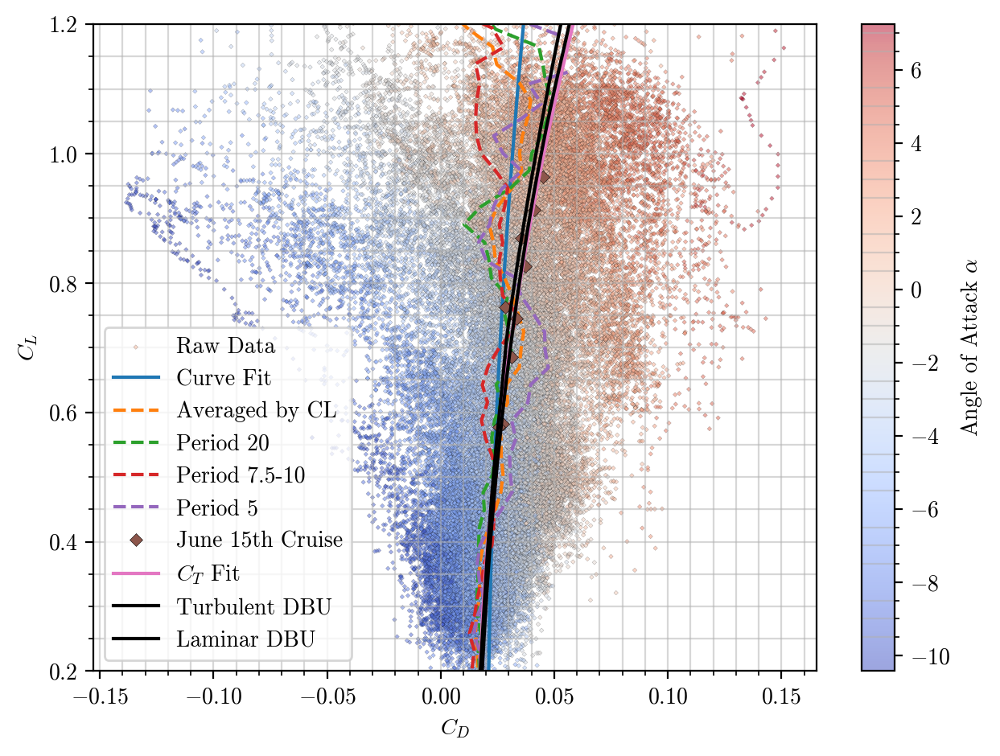

In [ ]:

fig_dragpolar = plt.figure(dpi=200)
cmap = plt.get_cmap('jet', 5)
plt.scatter(cdaoa_total, cl_total, c=np.rad2deg(aoa_total), cmap='coolwarm', marker='D', alpha=0.5, edgecolors=[0,0,0], s=2, linewidths=0.1, label='Raw Data')
plt.plot(CD_fitted, CL_fitted, marker='', markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew, linestyle='-', label='Curve Fit')
plt.plot(cd_means, np.array(cl_means), marker='', markeredgecolor=[0,0,0], markersize=5, markeredgewidth=markedgew, linestyle='--', label='Averaged by CL')
plt.plot(cd_means_1, np.array(cl_means_1), marker='', markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew, linestyle='--', label='Period 20')
plt.plot(cd_means_2, np.array(cl_means_2), marker='', markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew, linestyle='--', label='Period 7.5-10')
plt.plot(cd_means_3, np.array(cl_means_3), marker='', markeredgecolor=[0,0,0], markersize=3, markeredgewidth=markedgew, linestyle='--', label='Period 5')

plt.plot(ct_cruise_segresult_june13.ave_polar.CD, ct_cruise_segresult_june13.ave_polar.CL, marker='D', linestyle='', label="June 15th Cruise")
[CL_fitted, CD_fitted] = cl_finders.plotfittedpolar(createv, ct_cruise_segresult_june13.fit_polar, [0, 1.4])
plt.plot(CD_fitted, CL_fitted, marker='', linestyle='solid', label="$C_T$ Fit")

plt.plot(build_turbulent.CD, build_turbulent.CL, marker='', color='black', linestyle='solid', label="Turbulent DBU")
plt.plot(build_laminar.CD, build_laminar.CL, marker='', color='black', linestyle='solid', label="Laminar DBU")

plt.ylim([0.2, 1.2])
plt.legend()
plt.colorbar(label='Angle of Attack $\\alpha$')
plt.xlabel("$C_D$")
plt.ylabel("$C_L$")
plt.show()

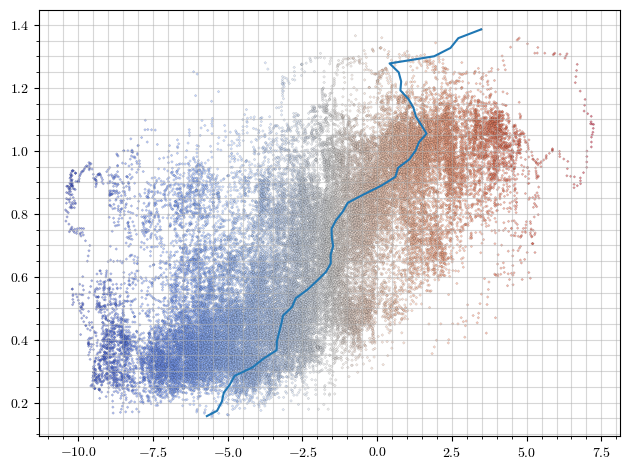

In [ ]:
fig_cl_alpha = plt.figure()
plt.scatter(np.rad2deg(aoa_total), cl_total, c=np.rad2deg(aoa_total), cmap='coolwarm', marker='D', alpha=0.5, edgecolors=[0,0,0], s=2, linewidths=0.1, label='Raw Data')
plt.plot(np.rad2deg(aoa_bin_means), cl_means, marker='', linestyle='solid')
plt.show()

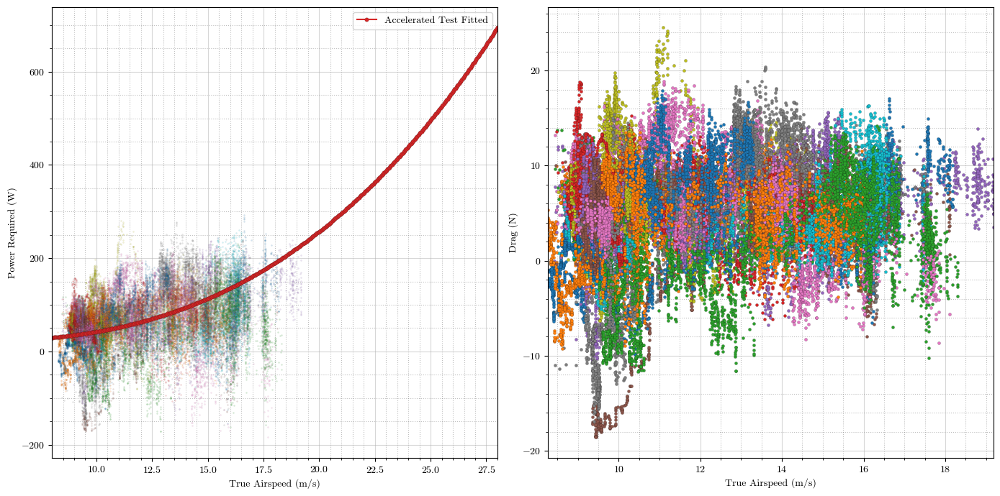

In [ ]:
# Overplotting the results of the 6 Accelerations #

P_acc, EAS = cl_finders.polar2preqew(createv, polar_acceleration, (8,28), createvstandardweight=False)

markerstyle = 'o'
markerevery = 1
markedgew = 0.1
plt.figure(figsize=(14,7))
ax1 = plt.subplot(1,2,1)
for i in range(len(masks)):
    ax1.plot(v_tas[masks[i]], P_req_r2[masks[i]], marker='.', markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew, linestyle='', alpha=0.2)
#ax1.plot(V_xflr, P_xflr, marker=markerstyle, markeredgecolor=[0,0,0], markersize=4, markevery=markerevery, markeredgewidth=markedgew, linestyle='-', label='XFLR Bare Wing')
ax1.plot(EAS, P_acc, marker=markerstyle, markeredgecolor=[0,0,0], markersize=4, markevery=markerevery, markeredgewidth=markedgew, linestyle='-', label='Accelerated Test Fitted')
ax1.set_ylabel("Power Required (W)")
ax1.set_xlabel("True Airspeed (m/s)")
ax1.grid(which='major', linestyle='-')
ax1.grid(which='minor', linestyle=':', color='grey')
ax1.legend()
ax1.autoscale(enable=True, axis='x', tight=True)

ax2 = plt.subplot(1,2,2)
for i in range(len(masks)):
    ax2.plot(v_tas[masks[i]], D[masks[i]], marker=markerstyle, markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew, linestyle='')
ax2.set_ylabel("Drag (N)")
ax2.set_xlabel("True Airspeed (m/s)")
ax2.grid(which='major', linestyle='-')
ax2.grid(which='minor', linestyle=':', color='grey')
ax2.autoscale(enable=True, axis='x', tight=True)
plt.tight_layout()
plt.show()

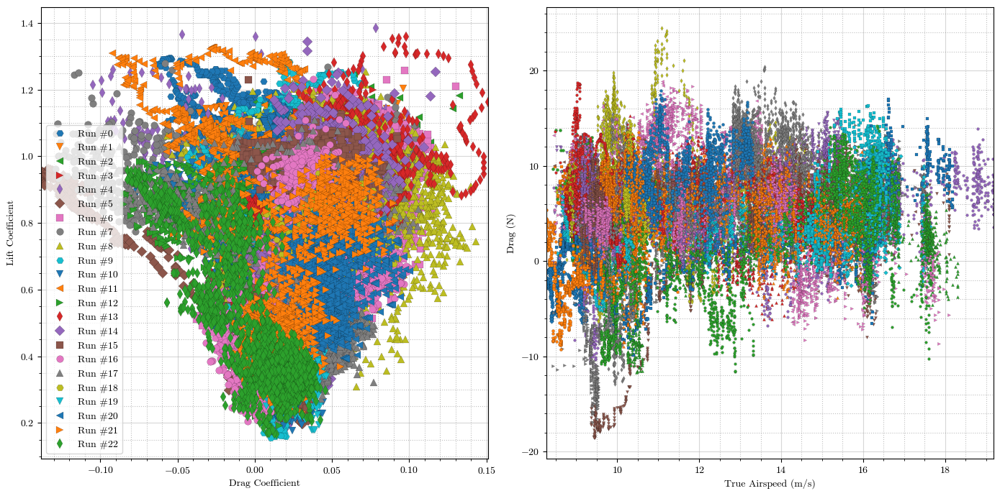

In [ ]:
# Plotting the drag polar of the Vehicle

markerstyle = 'o'
markerevery = 1
markedgew = 0.1
plt.figure(figsize=(14,7))
ax1 = plt.subplot(1,2,1)
for i in range(len(masks)):
    ax1.plot(CD_r2[masks[i]], CL[masks[i]], marker=next(marker), markeredgecolor=[0,0,0], markersize=7, markevery=markerevery, markeredgewidth=markedgew, linestyle='', label='Run #'+str(i))
ax1.set_ylabel("Lift Coefficient")
ax1.set_xlabel("Drag Coefficient")
ax1.grid(which='major', linestyle='-')
ax1.grid(which='minor', linestyle=':', color='grey')
ax1.autoscale(enable=True, axis='x', tight=True)
ax1.legend()

ax2 = plt.subplot(1,2,2)
for i in range(len(masks)):
    ax2.plot(v_tas[masks[i]], D[masks[i]], marker=next(marker), markeredgecolor=[0,0,0], markersize=3, markevery=markerevery, markeredgewidth=markedgew, linestyle='')
ax2.set_ylabel("Drag (N)")
ax2.set_xlabel("True Airspeed (m/s)")
ax2.grid(which='major', linestyle='-')
ax2.grid(which='minor', linestyle=':', color='grey')
ax2.autoscale(enable=True, axis='x', tight=True)
plt.tight_layout()
plt.show()

In [ ]:
# Standard Data Exporting and Prep

cl_total_stand = cl_finders.total_segments_boolean(CL, masks)
cd_total_stand = cl_finders.total_segments_boolean(CD_r2, masks)

# Taking totals and binning
bins = np.linspace(0.2, 1.4, 51)
[cl_means, cl_stds, cl_ci95s, cd_means, cd_stds, cd_ci95s] = cl_finders.collect_bins(bins, cl_total_stand, cd_total_stand)

# Fitting the results
polar_acc = cl_finders.cd2polar(createv, cd_means, cl_means, highorder=True)

# Packaging the results
acceleration_binresult = cl_finders.packaging_binresults(cl_total_stand, cl_means, cl_stds, cl_ci95s, cd_total_stand, cd_means, cd_stds, cd_ci95s, polar_acc, createv)

## <a id='toc1_13_'></a>[Exporting Results](#toc0_)

In [ ]:
# Exporting workspace
import dill
location = result_path + 'workspace.pkl'
dill.dump_session(location)

# Exporting polar data
pd.to_pickle(acceleration_binresult, result_path+'acceleration_binresult.pkl')

In [ ]:
df_example = df[1200000:1250000]

In [ ]:
## Generating Map Plots Descending ## 
token = "pk.eyJ1Ijoid2tlbXA5NCIsImEiOiJjbGI0NHJuemkwMmF2M29zM24xcTlpNXVjIn0.qSiAc29MftNSOK2DOpRggw"
color_scale = [(0, 'orange'), (1,'red')]

fig = px.scatter_mapbox(df_example, 
                        lat="Latitude", 
                        lon="Longitude", 
                        hover_name=df_example.index, 
                        #hover_data=["Address", "Listed"],
                        color="Airspeed_Sensor0",
                        color_continuous_scale='jet',
                        #size="Listed",
                        zoom=15.5, 
                        height=600,
                        width=900,
                        labels={"Airspeed_Sensor0": 'Airspeed (m/s)'},
                        template='presentation')
fig.update_layout(mapbox_style="satellite", mapbox_accesstoken=token)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.write_image(figure_path+"acc_path.pdf")
fig.show()

## <a id='toc1_14_'></a>[Being More Selective About Which accelerations to use](#toc0_)


Run 17 was poor, saw the flight path angle spike to >10 degrees, and the potential energy increase without any reason (kinetic loss or propulsion power).  Conclusion is that the flight encountered a wind gust most likely.  

In [ ]:
# Collecting bad runs
bad_segments = [5, 7, 17, 22]

/Users/williamkemp/Records/Repositories/CREATeV_AnalysisSuite/Investigations/21_Cleaned_Performance_Analysis/../../cl_finders.py:401: RuntimeWarning:

Mean of empty slice.

/Users/williamkemp/opt/anaconda3/envs/superwake-records/lib/python3.10/site-packages/numpy/core/_methods.py:189: RuntimeWarning:

invalid value encountered in double_scalars

/Users/williamkemp/opt/anaconda3/envs/superwake-records/lib/python3.10/site-packages/numpy/core/_methods.py:262: RuntimeWarning:

Degrees of freedom <= 0 for slice

/Users/williamkemp/opt/anaconda3/envs/superwake-records/lib/python3.10/site-packages/numpy/core/_methods.py:222: RuntimeWarning:

invalid value encountered in true_divide

/Users/williamkemp/opt/anaconda3/envs/superwake-records/lib/python3.10/site-packages/numpy/core/_methods.py:254: RuntimeWarning:

invalid value encountered in double_scalars

/Users/williamkemp/Records/Repositories/CREATeV_AnalysisSuite/Investigations/21_Cleaned_Performance_Analysis/../../cl_finders.py:405: Runtim

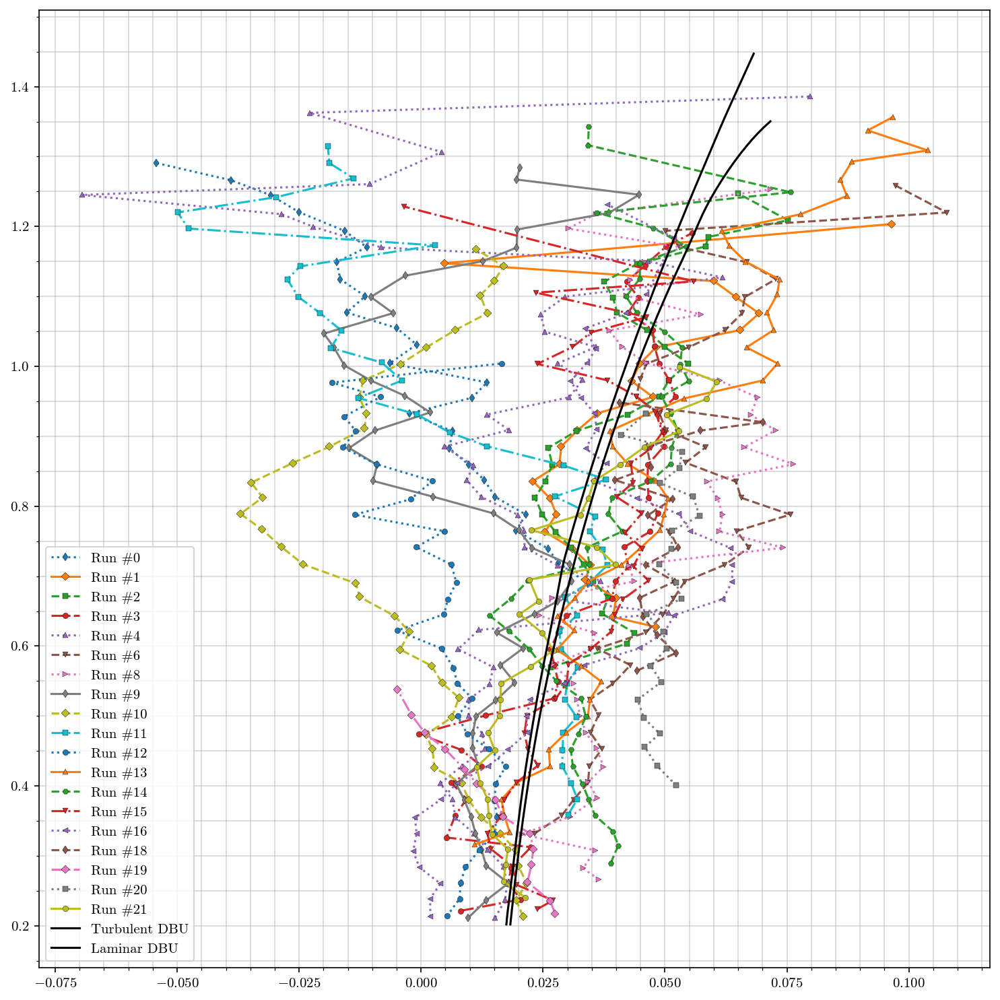

In [ ]:
# Plotting only good runs

marker = itertools.cycle(('d', 'D', 's', 'o', '^', 'H', 'v', '<', '>'))
linestyles = itertools.cycle(('dotted', 'solid', 'dashed', 'dashdot'))


plt.figure(figsize=(10,10), dpi=150)
cmap = plt.get_cmap('PuOr', 5)

for i in range(len(masks)):
    if i in bad_segments:
        next(linestyles)
        next(marker)
        continue
    else:
        cl_total_run = cl_finders.total_segments_boolean(CL, masks, np.array([i]))
        cd_total_run = cl_finders.total_segments_boolean(CD_r1, masks, [i])

        aoa_total_run = cl_finders.total_segments_boolean(alpha, masks, [i])
        P_total_run = cl_finders.total_segments_boolean(P, masks, [i])
        Q_total_run = cl_finders.total_segments_boolean(Q, masks, [i])
        theta_total_run = cl_finders.total_segments_boolean(theta, masks, [i])
        gamma_total_run = cl_finders.total_segments_boolean(gamma, masks, [i])
        h_dot_total_run = cl_finders.total_segments_boolean(Vd_tas, masks, [i])

        [cl_means_run, NaN, NaN, cd_means_run, NaN, NaN] = cl_finders.collect_bins(bins, cl_total_run, cd_total_run)
        plt.plot(cd_means_run, cl_means_run, linestyle=next(linestyles), marker=next(marker), label="Run #"+str(i))
        # plt.scatter(cd_total_run, cl_total_run, c=np.rad2deg(gamma_total_run), cmap=cmap, marker='o', alpha=1, edgecolors=[0,0,0], s=7, linewidths=0.1)
plt.plot(build_turbulent.CD, build_turbulent.CL, marker='', color='black', linestyle='solid', label="Turbulent DBU")
plt.plot(build_laminar.CD, build_laminar.CL, marker='', color='black', linestyle='solid', label="Laminar DBU")
# plt.colorbar(label='$\gamma$')
plt.legend()
plt.show()

In [ ]:
cl_total = np.array([])
cd_total = np.array([])
selection = np.arange(22)
bad_selection = [0, 5, 6, 7, 10, 16, 17, 22]

for i in selection:
    if i in bad_selection:
        continue
    cl_total = np.append(cl_total, CL_exp[masks[i]])
    cd_total = np.append(cd_total, CD_r2[masks[i]])
digitized = np.digitize(cl_total, bins)
cl_means = [cl_total[digitized == i].mean() for i in range(1, len(bins))]
cd_means = [cd_total[digitized == i].mean() for i in range(1, len(bins))]

In [ ]:
# Fitting only to CL 1.1 and less

cl_total_low = cl_total[cl_total < 1.1]
cd_total_low = cd_total[cl_total < 1.1]

polar_acceleration = cl_finders.cd2polar(createv, cd_total_low, cl_total_low, highorder=False)
polar_2022_ct = cl_finders.cd2polar(createv, ct_cruise_segresult_june13.ave_polar.CD, ct_cruise_segresult_june13.ave_polar.CL, highorder=False)

[CL_fitted_CT, CD_fitted_CT] = cl_finders.plotfittedpolar(createv, polar_2022_ct, [0.2, 1.1])
[CL_fitted_ACC, CD_fitted_ACC] = cl_finders.plotfittedpolar(createv, polar_acceleration, [0.2, 1.1])

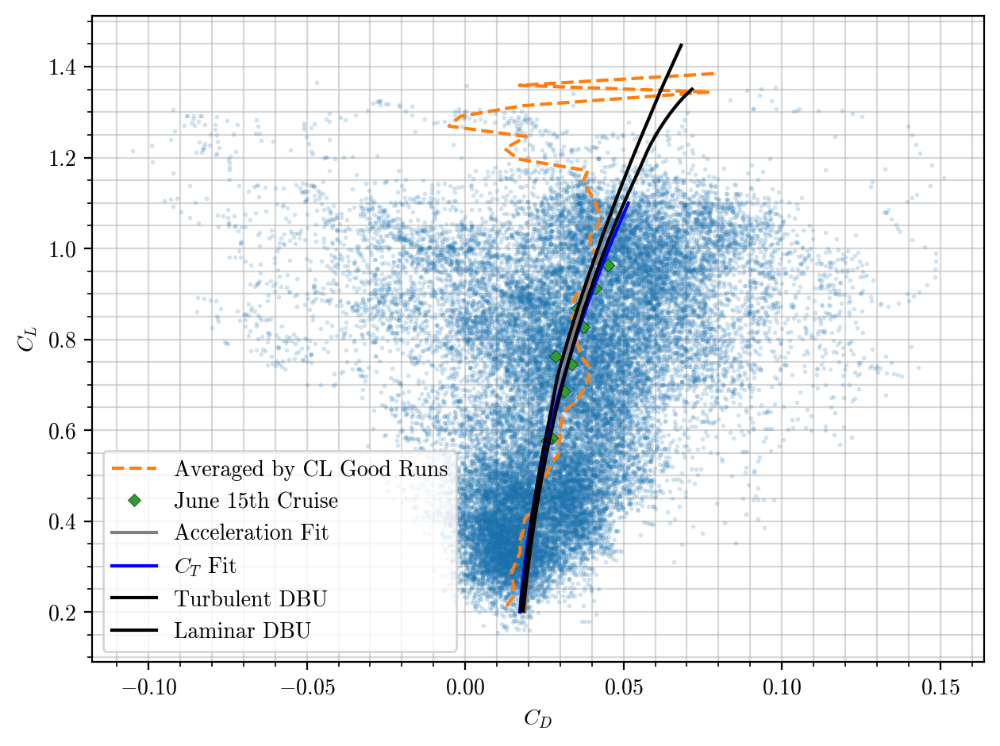

In [ ]:
fig_dragpolar = plt.figure(dpi=200)
cmap = plt.get_cmap('jet', 5)
plt.plot(cd_total, cl_total, marker="o", markersize=2, markeredgewidth=0.01, markeredgecolor='black', linestyle='', alpha=0.2)
plt.plot(cd_means, np.array(cl_means), marker='', markeredgecolor=[0,0,0], markersize=5, markeredgewidth=markedgew, linestyle='--', label='Averaged by CL Good Runs')
plt.plot(ct_cruise_segresult_june13.ave_polar.CD, ct_cruise_segresult_june13.ave_polar.CL, marker='D', linestyle='', label="June 15th Cruise")

plt.plot(CD_fitted_ACC, CL_fitted_ACC, marker='', color='grey', linestyle='solid', label="Acceleration Fit")
plt.plot(CD_fitted_CT, CL_fitted_CT, marker='', color='blue', linestyle='solid', label="$C_T$ Fit")

plt.plot(build_turbulent.CD, build_turbulent.CL, marker='', color='black', linestyle='solid', label="Turbulent DBU")
plt.plot(build_laminar.CD, build_laminar.CL, marker='', color='black', linestyle='solid', label="Laminar DBU")

plt.legend()
plt.xlabel("$C_D$")
plt.ylabel("$C_L$")
plt.show()